In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

# dropout data aggregation


In [ ]:
# read in sql_course_items_joined and print the shape and columns
df_items = pd.read_csv('/content/drive/MyDrive/MOOC_Feature_Project/MOOC-Pipeline/data_preprocess_EDA/raw_data/sql_course_items_joined_11_17.csv')
num_course_item = df_items.course_id.nunique()
print(f'number of courses has course items: {num_course_item}')

# read in course grades
df_grades = pd.read_csv('/content/drive/MyDrive/MOOC_Feature_Project/MOOC-Pipeline/data_preprocess_EDA/raw_data/sql_course_grade_11_20.csv')
num_course_grade = df_grades.course_id.nunique()
print(f'number of courses has course grades: {num_course_grade}')

# read in course completion rate
df_completion = pd.read_csv('/content/drive/MyDrive/MOOC_Feature_Project/MOOC-Pipeline/data_preprocess_EDA/raw_data/sql_course_completion_rate_11_20.csv')
num_course_completion = df_completion.course_id.nunique()
print(f'number of courses has course completion rate: {num_course_completion}')

number of courses has course items: 208
number of courses has course grades: 162
number of courses has course completion rate: 159


In [ ]:
# inner join three files
df = pd.merge(df_items, df_grades, on='course_id', how='inner')
df = pd.merge(df, df_completion, on='course_id', how='inner')
num_course_joined = df.course_id.nunique()
print(f'number of courses has course items, grades, and completion rate: {num_course_joined}')

number of courses has course items, grades, and completion rate: 155


In [ ]:
# feature engineering
df['quiz_is_graded'] = df['quiz_is_graded'].astype(bool)

aggregated_df = df.groupby('course_id').agg(
    course_name=('course_name_x', 'first'),
    course_slug=('course_slug', 'first'),
    course_desc=('course_desc', 'first'),
    course_level=('course_level', 'first'),
    estimated_workload=('estimated_work_load', 'first'),
    course_graded=('course_graded', 'first'),
    course_restricted=('course_restricted', 'first'),
    num_unique_branch=('course_branch_id', 'nunique'),
    num_module=('course_module_id', 'count'),
    num_lessons=('course_lesson_id', 'nunique'),
    mum_course_items=('course_item_id', 'nunique'),
    honor_lesson_ratio=('is_in_honor_lesson', 'mean'),
    avg_duration_by_items_ms=('course_branch_item_lecture_duration_ms', 'mean'),
    avg_duration_by_items_minutes=('course_branch_item_lecture_duration_ms', lambda x: x.sum()/(len(x) * 1000 * 60)),
    num_quizs=('quiz_assessment_id', 'nunique'),
    graded_quiz_ratio=('quiz_is_graded', 'mean'),
    avg_completion_ratio=('completion_ratio', 'mean'),
    avg_passing_rate=('avg_passing_rate', 'mean'),
    avg_passed_item=('avg_passed_items', 'mean'),
    avg_grade=('avg_course_grade', 'mean')
).reset_index()

# Display the DataFrame to the user
print(aggregated_df.head())

                course_id                                   course_name  \
0  -FpKiRmcEem6cA6kboa4Lg                                 Copyright Law   
1  0BhbnWBTEemJSwqhjZsp9g   Lending, Crowdfunding, and Modern Investing   
2  0ej5C6CJEeiAExLt68dqiA    Computational Thinking for Problem Solving   
3  0jwqe3EyEeWxvQr3acyajw                 Social Norms, Social Change I   
4  1BWQ2MOEEeS3kiIACx2NTg  Calculus: Single Variable Part 1 - Functions   

                                         course_slug  \
0                                      copyright-law   
1  wharton-crowdfunding-marketplace-lending-moder...   
2             computational-thinking-problem-solving   
3                                              norms   
4                           single-variable-calculus   

                                         course_desc course_level  \
0  Copyright law is unique in the greater intelle...         None   
1  In this course, you’ll learn the foundational ...     BEGINNER   
2  Co

# Xing's feature addition

In [ ]:
# df read in
df_1 = pd.read_csv('/content/drive/MyDrive/MOOC_Feature_Project/MOOC-Pipeline/data_preprocess_EDA/raw_data/sql_course_assessment_counts_12_25.csv')
df_2 = pd.read_csv('/content/drive/MyDrive/MOOC_Feature_Project/MOOC-Pipeline/data_preprocess_EDA/raw_data/sql_course_forums_count_12_25.csv')
df = pd.merge(df_1, df_2, on=['course_id', 'course_branch_id'], how='inner')

# select course related columns
df = df[['course_id', 'course_branch_id','on_demand_session_id','on_demand_sessions_start_ts', 'on_demand_sessions_end_ts',
         'unique_forum_count', 'unique_assessment_count',
       'unique_peer_assignment_count', 'unique_programming_assignment_count', 'total_required_review_count',
       'max_peer_assignment_types', 'max_submission_types']].drop_duplicates()

# add course date by using 'on_demand_sessions_start_ts', 'on_demand_sessions_end_ts'
df['on_demand_sessions_start_ts'] = pd.to_datetime(df['on_demand_sessions_start_ts'])
df['on_demand_sessions_end_ts'] = pd.to_datetime(df['on_demand_sessions_end_ts'])
df['course_days'] = (df['on_demand_sessions_end_ts'] - df['on_demand_sessions_start_ts']).dt.days
df['asssignemnt_count'] = df['unique_peer_assignment_count'] + df['unique_programming_assignment_count']

# aggregate on a course level
df_xing = df.groupby(['course_id'])[['course_days','unique_forum_count', 'unique_assessment_count',
       'asssignemnt_count', 'total_required_review_count','max_peer_assignment_types',
       'max_submission_types']].mean().reset_index()
df_xing.columns = ['course_id', 'course_days', 'forum_counts', 'assessment_counts',
       'asssignemnt_counts', 'required_review_counts','grading_types',
       'submission_types']

# dropout rate eda with Xing's data

In [ ]:
import pandas as pd

# Function to display EDA results
def eda_numeric_and_boolean(df):
    # Numeric columns
    numeric_cols = df.select_dtypes(include=['number'])
    print("Numeric Columns Summary:")
    for col in numeric_cols.columns:
        print(f"\nColumn: {col}")
        print(f"  Min: {numeric_cols[col].min():.2f}")
        print(f"  25th Percentile: {numeric_cols[col].quantile(0.25):.2f}")
        print(f"  Median: {numeric_cols[col].median():.2f}")
        print(f"  Mean: {numeric_cols[col].mean():.2f}")
        print(f"  75th Percentile: {numeric_cols[col].quantile(0.75):.2f}")
        print(f"  Max: {numeric_cols[col].max():.2f}")
        print(f"  Max {col} Course Name: {df.loc[numeric_cols[col].idxmax(), 'course_name']}")
        print(f". Min {col} Course Name: {df.loc[numeric_cols[col].idxmin(), 'course_name']}")

    # Boolean columns
    boolean_cols = df.select_dtypes(include=['bool'])
    print("\nBoolean Columns Summary:")
    for col in boolean_cols.columns:
        print(f"\nColumn: {col}")
        print(f"  Sum of True: {boolean_cols[col].sum()}")
        print(f"  Sum of False: {len(boolean_cols[col]) - boolean_cols[col].sum()}")
        print(f"  Average of True: {boolean_cols[col].mean():.2f}")

# Run EDA on augmented_df
augmented_df = pd.merge(aggregated_df, df_xing, on='course_id', how='left')
eda_numeric_and_boolean(augmented_df)

Numeric Columns Summary:

Column: num_unique_branch
  Min: 1.00
  25th Percentile: 1.00
  Median: 1.00
  Mean: 1.81
  75th Percentile: 2.00
  Max: 7.00
  Max num_unique_branch Course Name: Introduction to Corporate Finance
. Min num_unique_branch Course Name: Copyright Law

Column: num_module
  Min: 24.00
  25th Percentile: 45.00
  Median: 62.00
  Mean: 117.52
  75th Percentile: 116.50
  Max: 896.00
  Max num_module Course Name: English for Business and Entrepreneurship
. Min num_module Course Name: Crowdfunding

Column: num_lessons
  Min: 4.00
  25th Percentile: 4.00
  Median: 8.00
  Mean: 11.19
  75th Percentile: 14.50
  Max: 40.00
  Max num_lessons Course Name: Introduction to Python Programming
. Min num_lessons Course Name: Lending, Crowdfunding, and Modern Investing

Column: mum_course_items
  Min: 24.00
  25th Percentile: 39.00
  Median: 52.00
  Mean: 61.19
  75th Percentile: 64.50
  Max: 422.00
  Max mum_course_items Course Name: Modern & Contemporary American Poetry (“ModPo”)


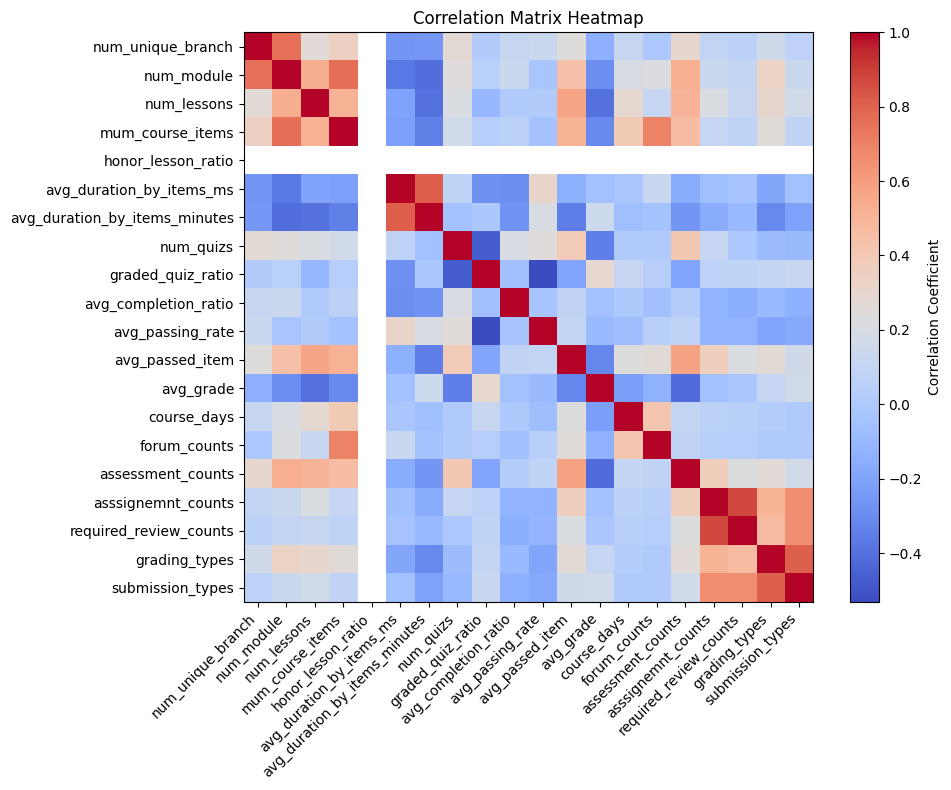

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np

# Select numerical columns
numeric_cols = augmented_df.select_dtypes(include=['number'])

# Compute the correlation matrix
correlation_matrix = numeric_cols.corr()

# Plot the heatmap
plt.figure(figsize=(10, 8))
plt.imshow(correlation_matrix, cmap='coolwarm', interpolation='none')
plt.colorbar(label='Correlation Coefficient')
plt.xticks(np.arange(len(correlation_matrix.columns)), correlation_matrix.columns, rotation=45, ha='right')
plt.yticks(np.arange(len(correlation_matrix.columns)), correlation_matrix.columns)
plt.title('Correlation Matrix Heatmap')
plt.tight_layout()
plt.show()

# course branch item trend

In [ ]:
item_grades_df = pd.read_csv('/content/drive/MyDrive/MOOC_Feature_Project/MOOC-Pipeline/data_preprocess_EDA/raw_data/sql_course_branch_item_user_trend_1_8.csv')
print(item_grades_df.shape)

(22487, 17)


In [ ]:
# create a copy of original dataframe
df = item_grades_df.copy()

# filter to contain only graded items
df = item_grades_df[item_grades_df['is_graded'] == True]

# filter to contain the original course branch
df = df[df['course_branch_id'] == df['course_id']]

print(df.shape)

(1449, 17)


In [ ]:
# unique user normalization and order graded items
df = df[df['unique_user_count'] != 0]

# Step 1: Sort by course_id and hierarchical order
df = df.sort_values(by=['course_branch_id', 'course_branch_module_order', 'course_branch_lesson_order', 'course_branch_item_order'])

# Step 2: Generate a global item order within each course
df['graded_item_order'] = df.groupby(['course_branch_id']).cumcount() + 1

# Step 2: Calculate maximum user count for each course
df['max_users_per_course'] = df.groupby('course_branch_id')['unique_user_count'].transform('max')

# Step 3: Normalize filled user count by maximum
df['normalized_user_percentage'] = df['unique_user_count'] / df['max_users_per_course']

# Normalize global item order within each course
df['max_order'] = df.groupby('course_id')['graded_item_order'].transform('max')
df['normalized_order'] = df['graded_item_order'] / df['max_order']

## individual course dropout trend visuals

<ipython-input-6-cc92c7be1481>:5: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  df['item_weight_in_course_branch_percentage'].fillna(-50, inplace=True)


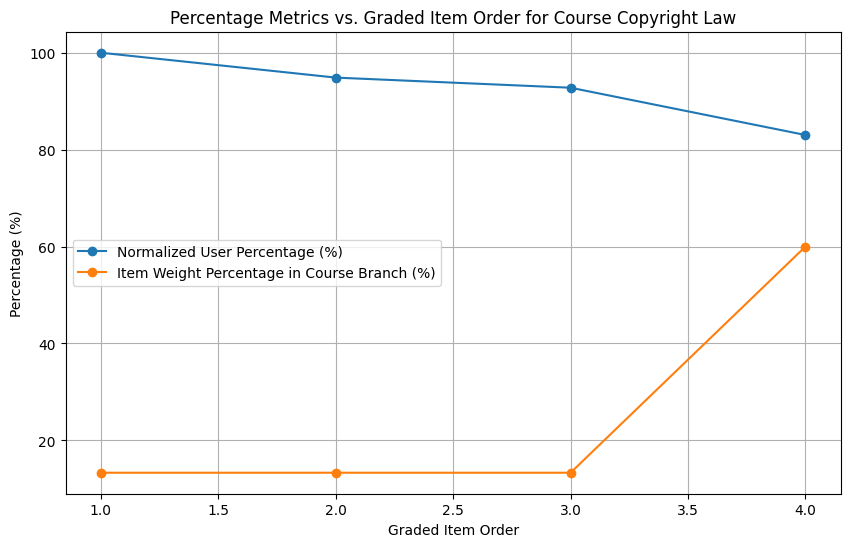

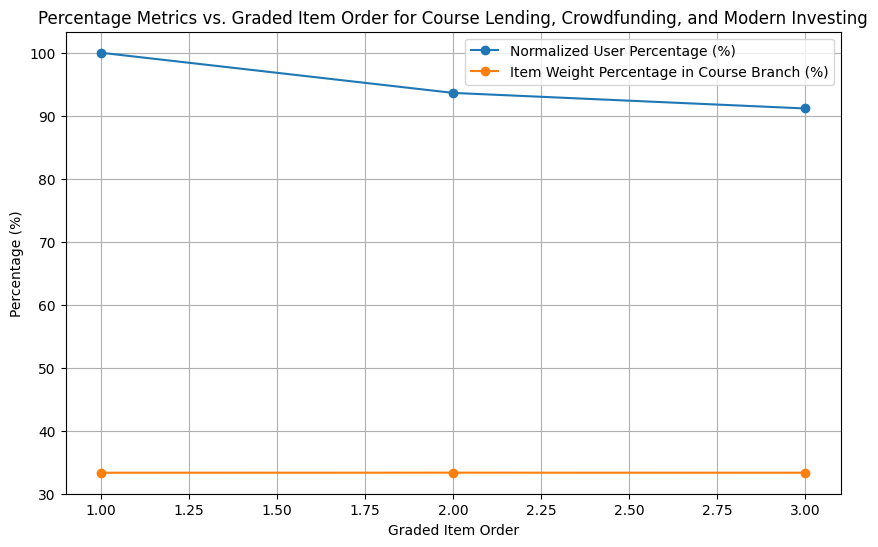

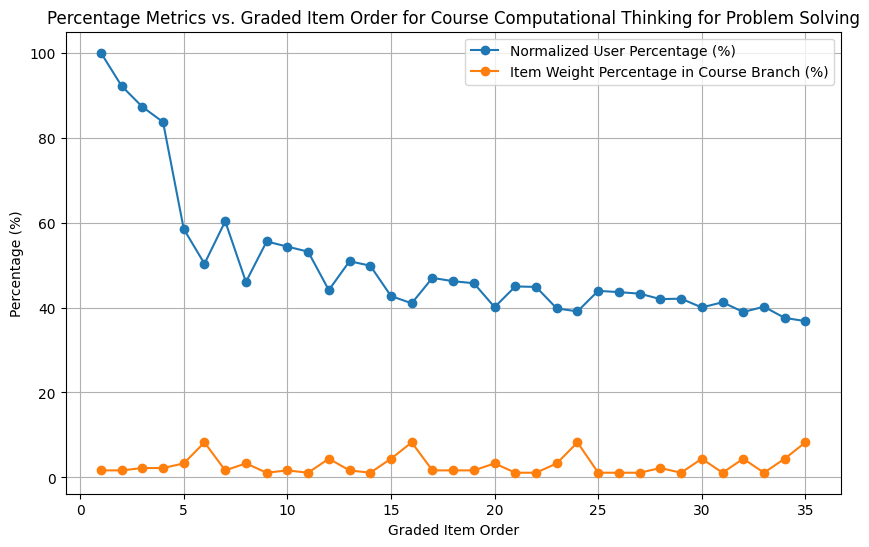

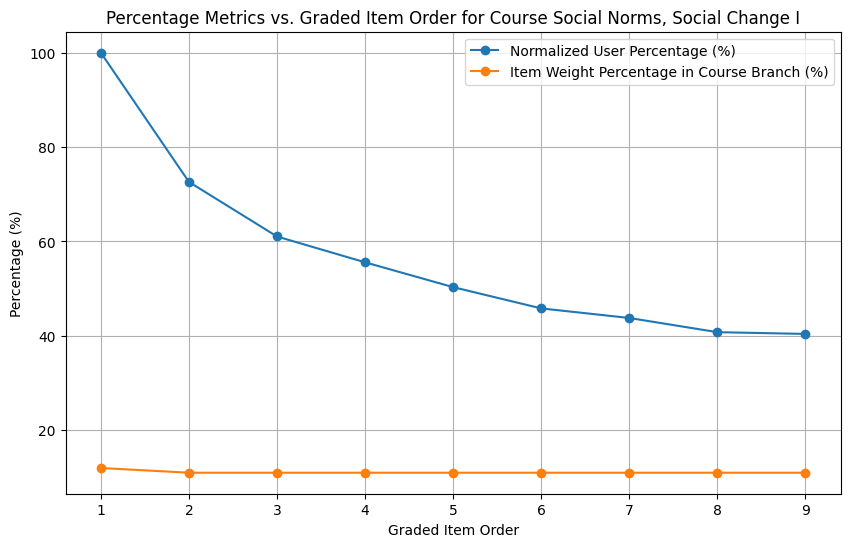

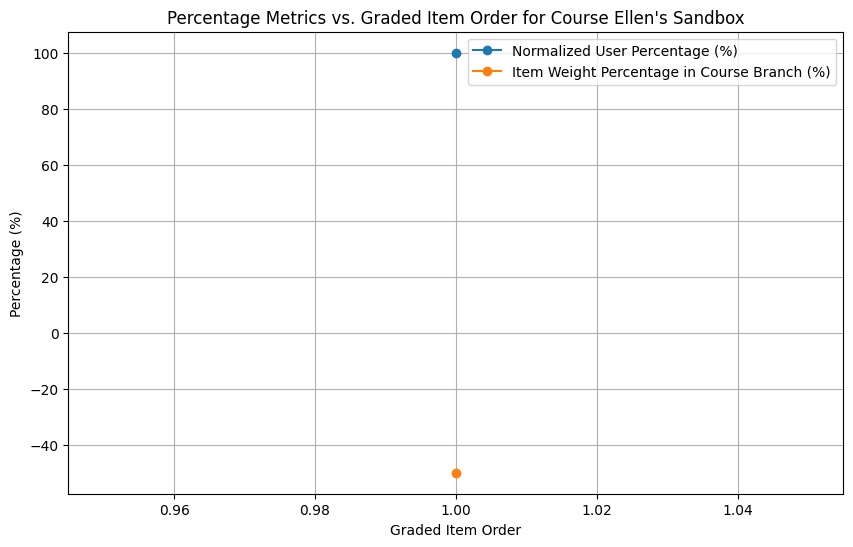

...

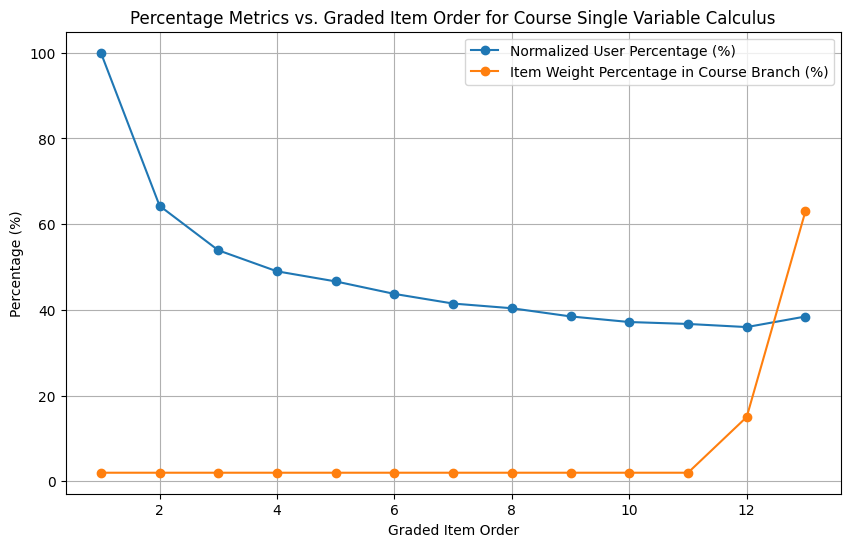

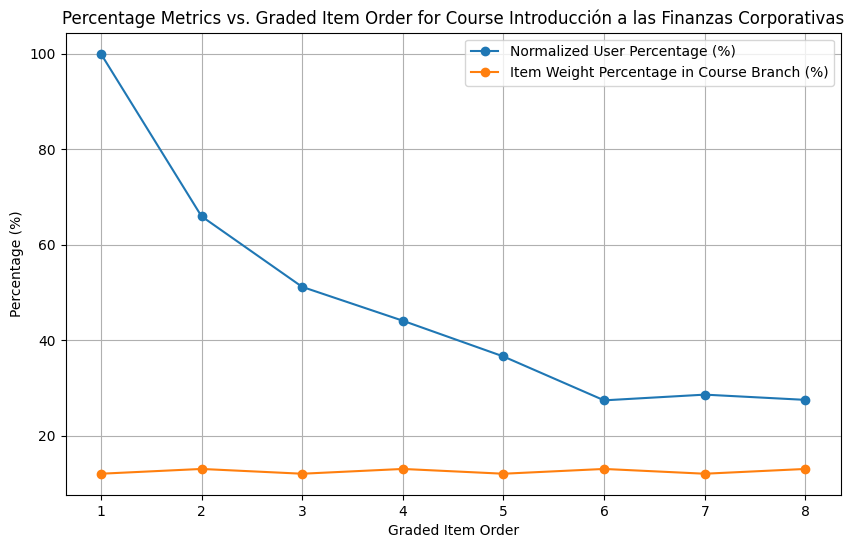

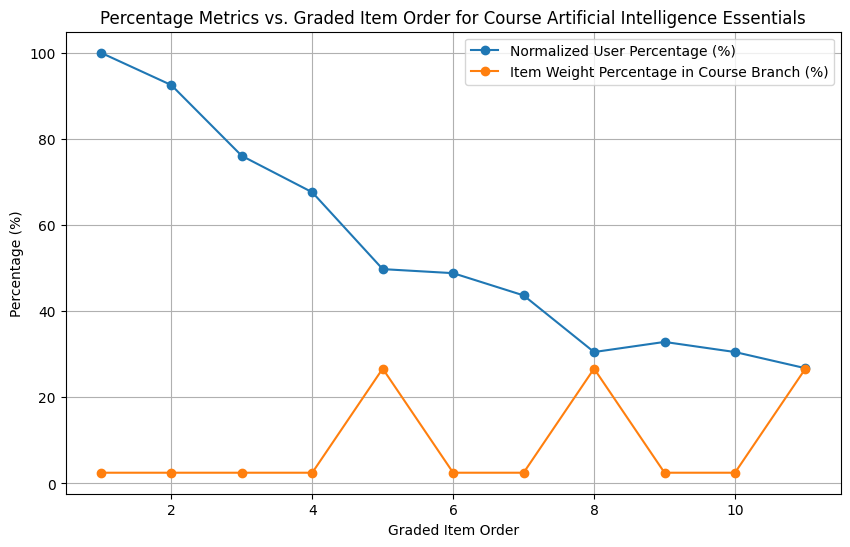

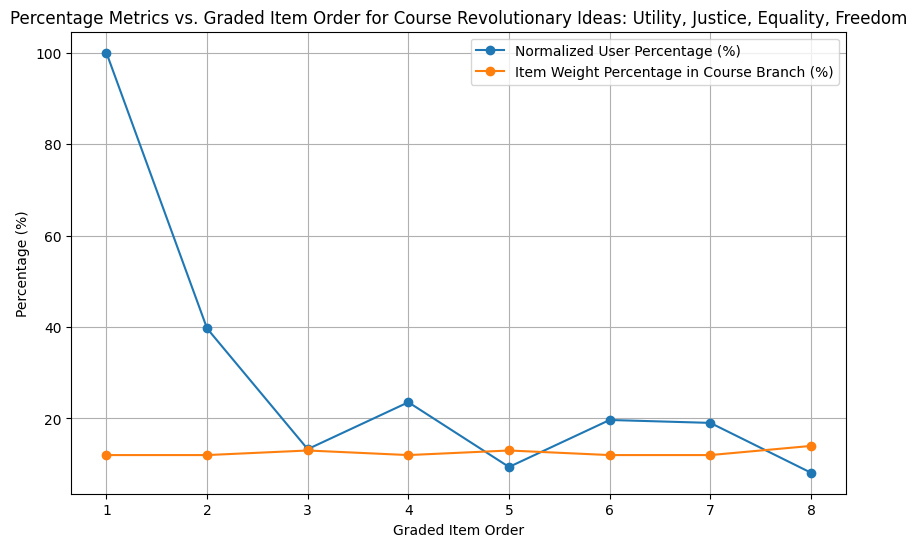

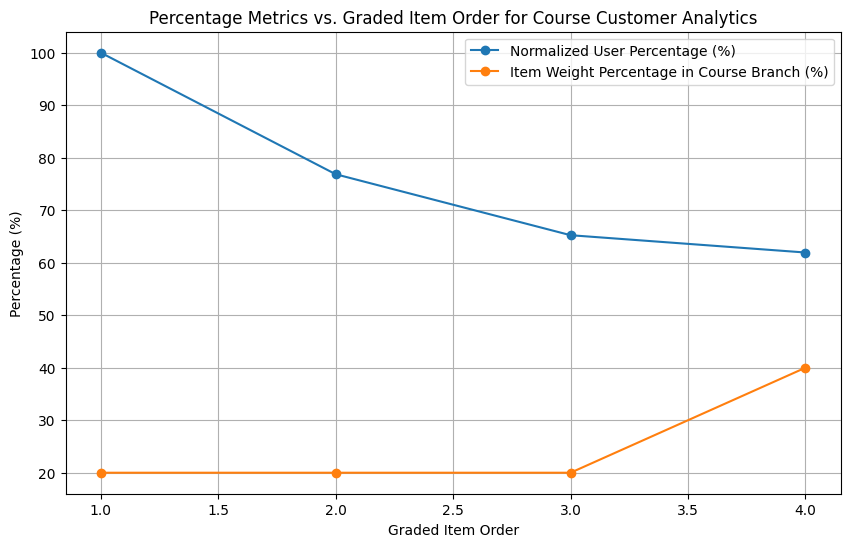

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 47196 (\N{HANGUL SYLLABLE RO}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 48391 (\N{HANGUL SYLLABLE BOS}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 44277 (\N{HANGUL SYLLABLE GONG}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 54617 (\N{HANGUL SYLLABLE HAG}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 52897 (\N{HANGUL SYLLABLE KAEB}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages

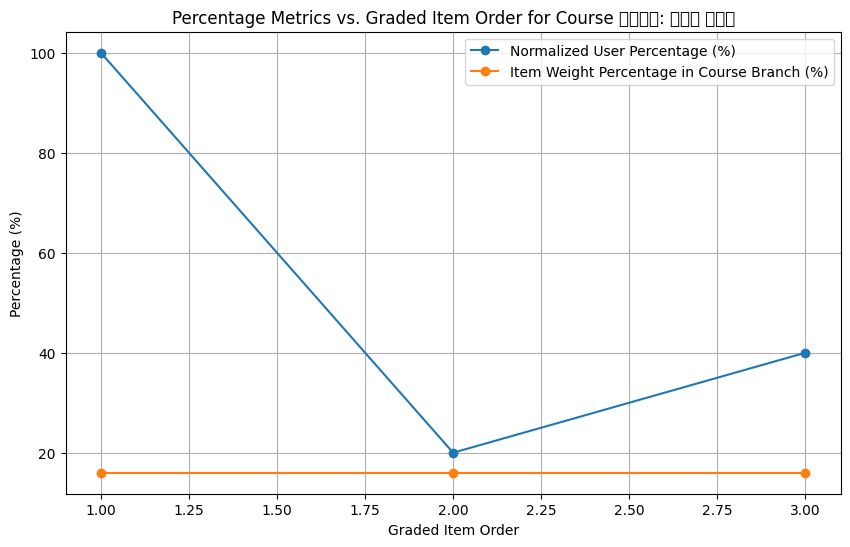

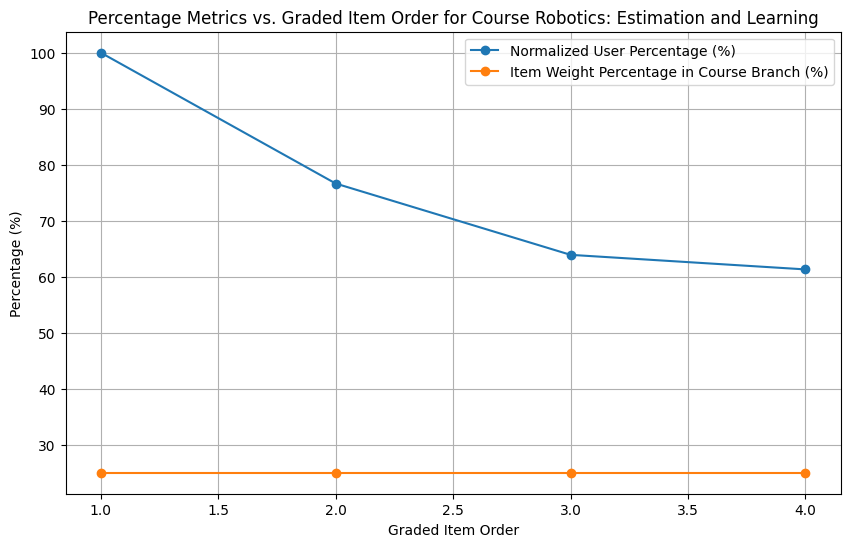

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 20225 (\N{CJK UNIFIED IDEOGRAPH-4F01}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 19994 (\N{CJK UNIFIED IDEOGRAPH-4E1A}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 37329 (\N{CJK UNIFIED IDEOGRAPH-91D1}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 34701 (\N{CJK UNIFIED IDEOGRAPH-878D}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 27010 (\N{CJK UNIFIED IDEOGRAPH-6982}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/

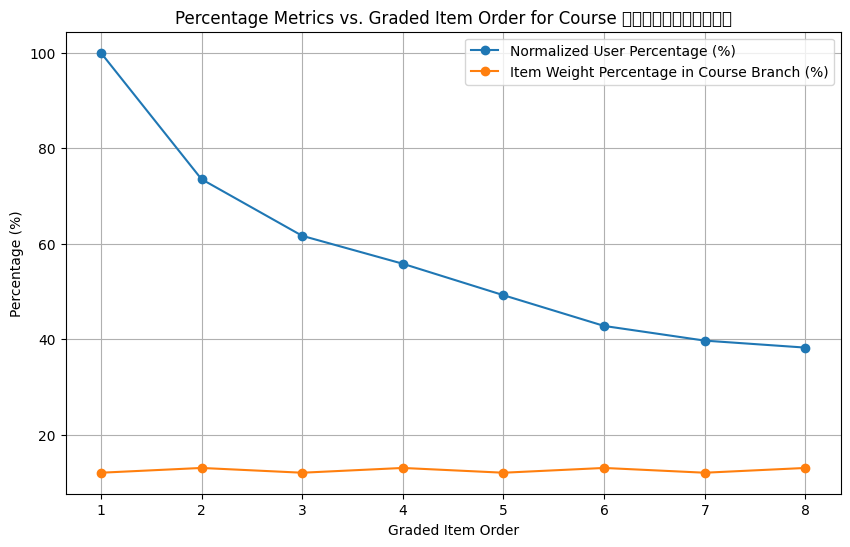

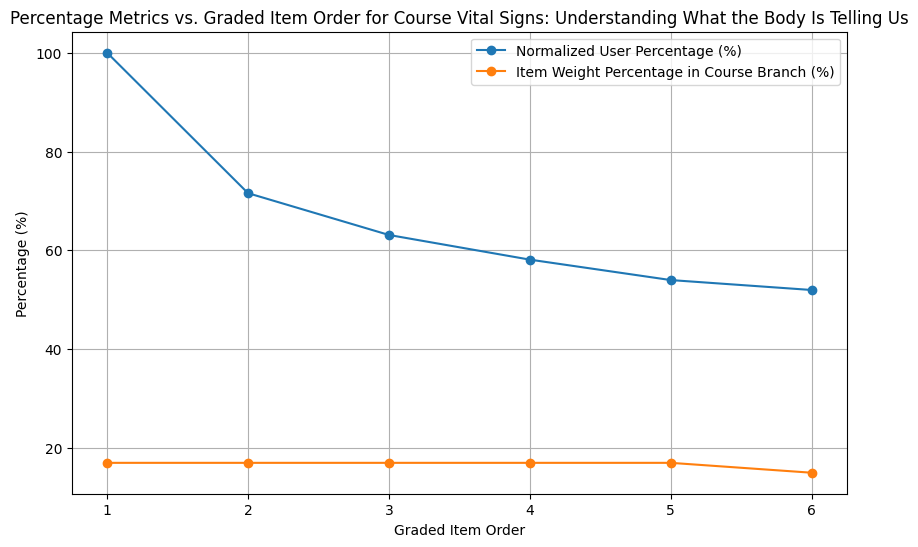

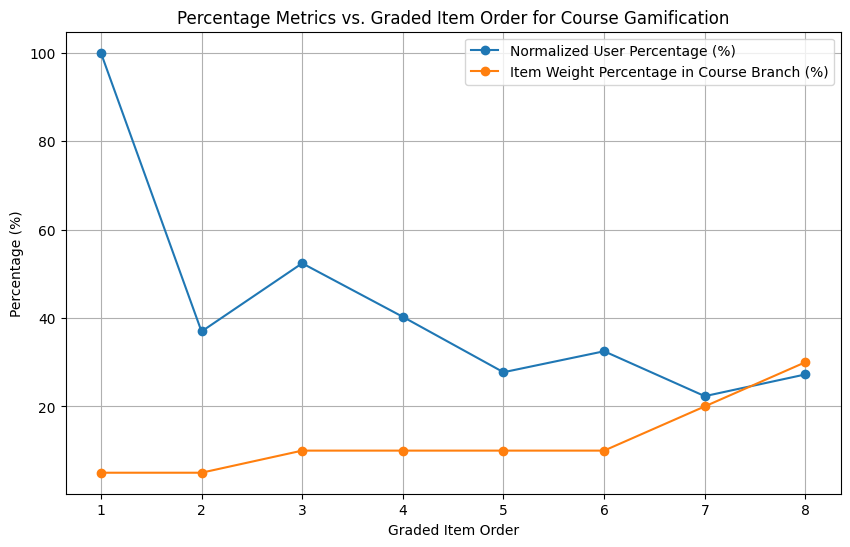

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 36130 (\N{CJK UNIFIED IDEOGRAPH-8D22}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 21153 (\N{CJK UNIFIED IDEOGRAPH-52A1}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 20250 (\N{CJK UNIFIED IDEOGRAPH-4F1A}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 35745 (\N{CJK UNIFIED IDEOGRAPH-8BA1}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


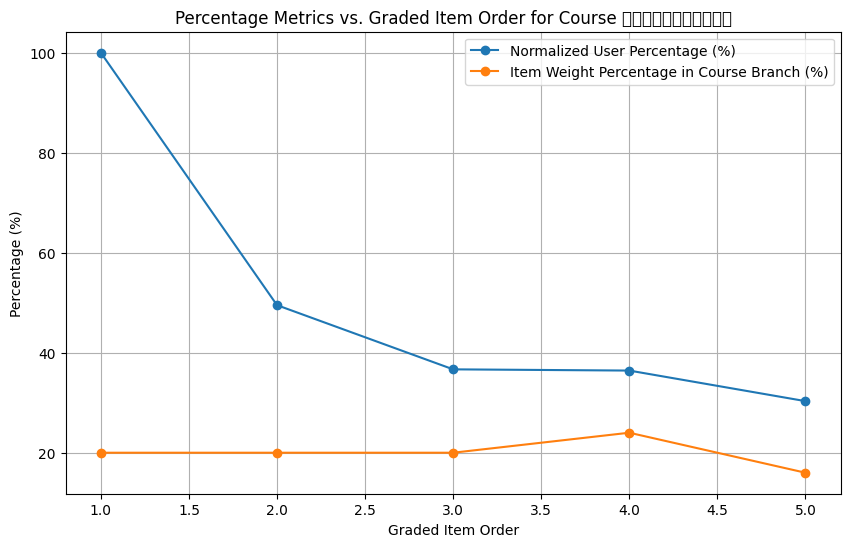

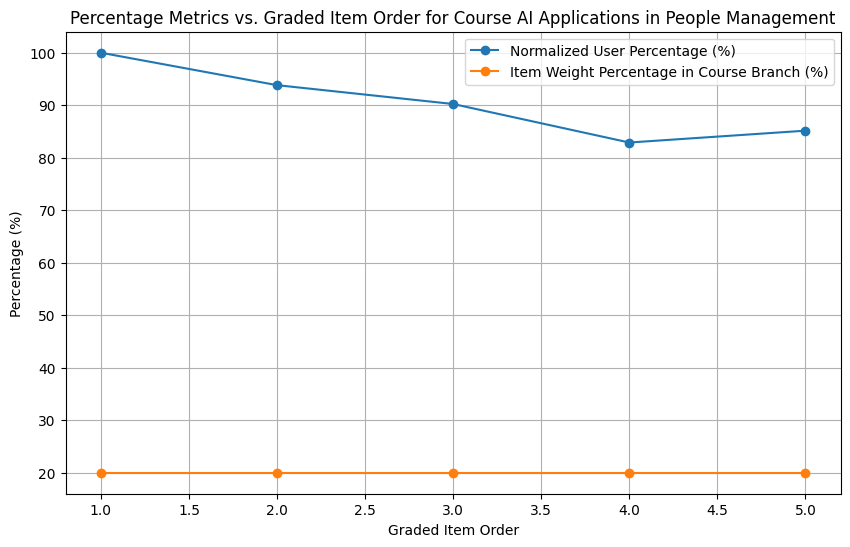

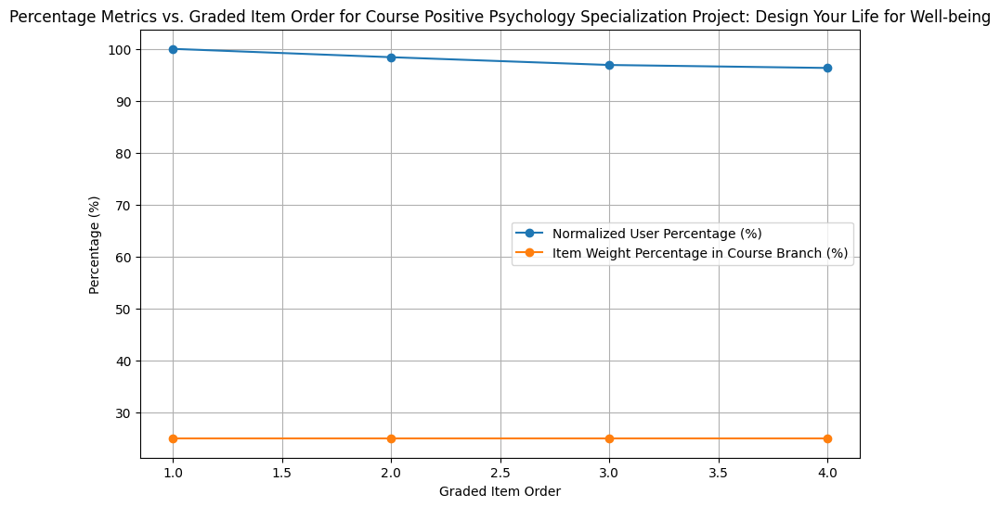

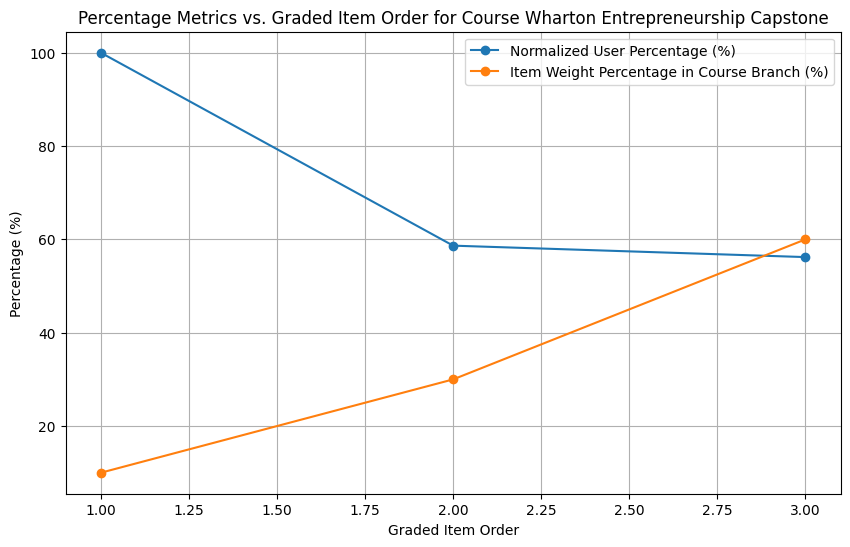

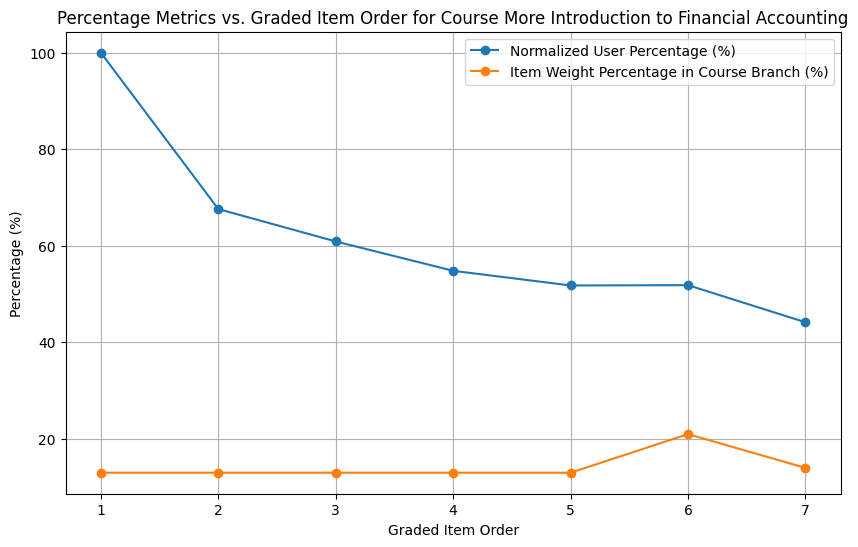

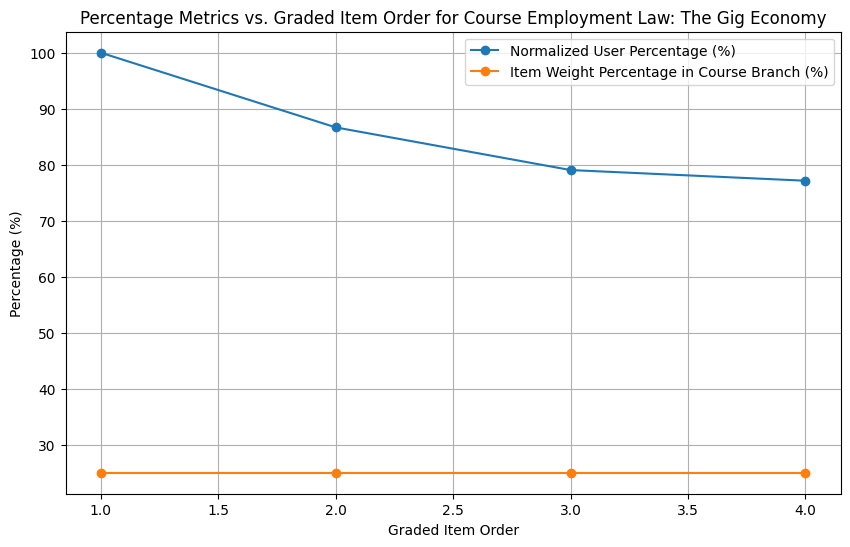

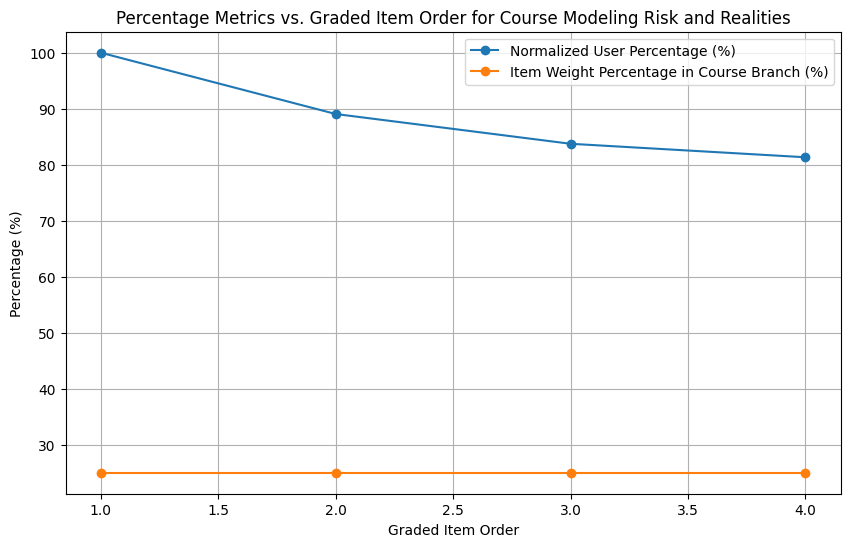

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 27779 (\N{CJK UNIFIED IDEOGRAPH-6C83}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 39039 (\N{CJK UNIFIED IDEOGRAPH-987F}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 21830 (\N{CJK UNIFIED IDEOGRAPH-5546}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 22522 (\N{CJK UNIFIED IDEOGRAPH-57FA}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 30784 (\N{CJK UNIFIED IDEOGRAPH-7840}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/

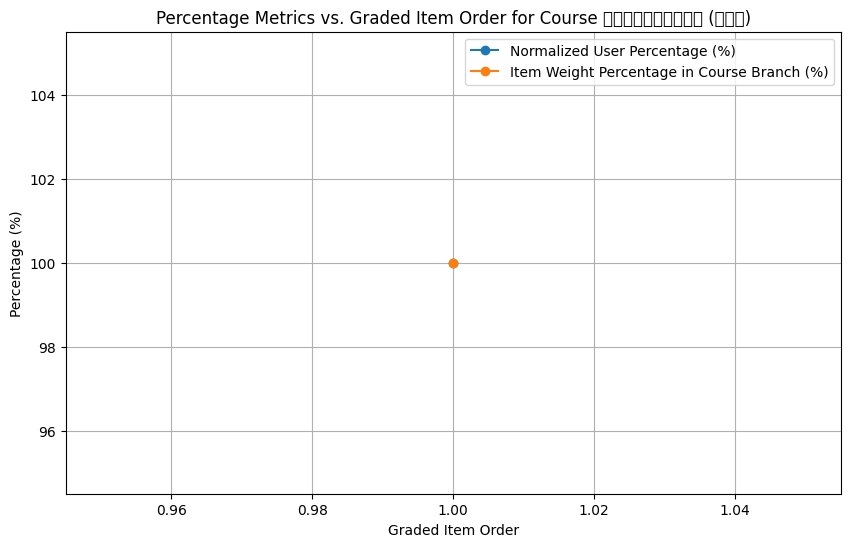

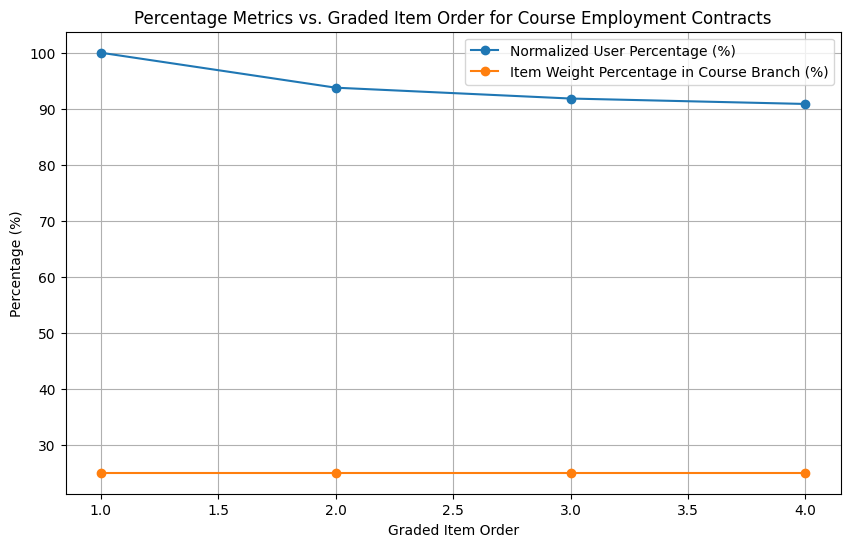

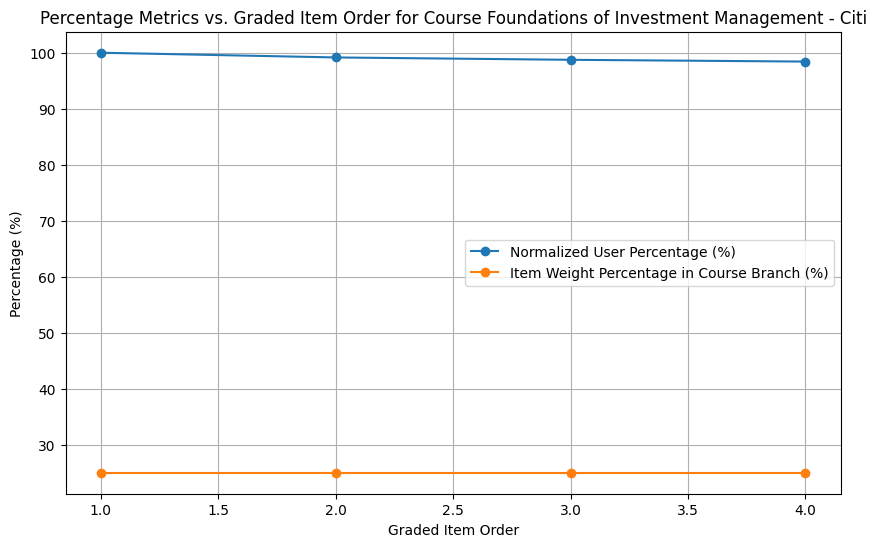

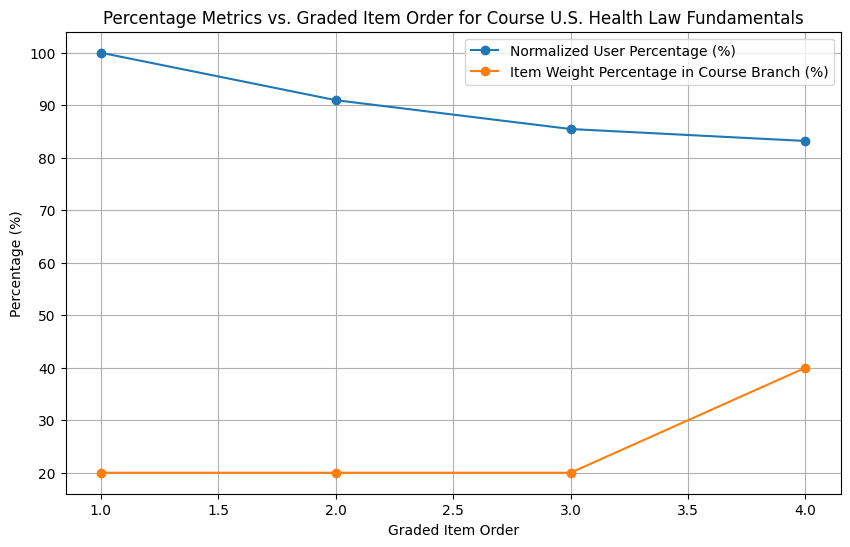

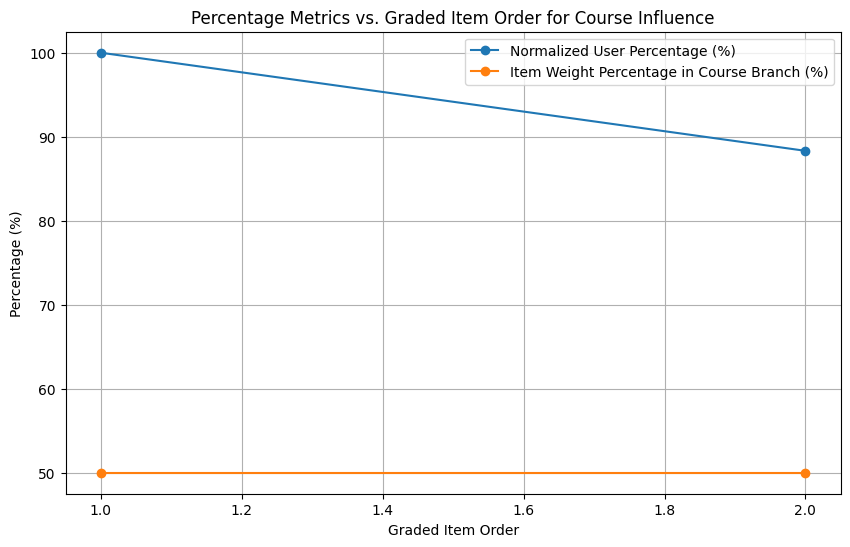

...

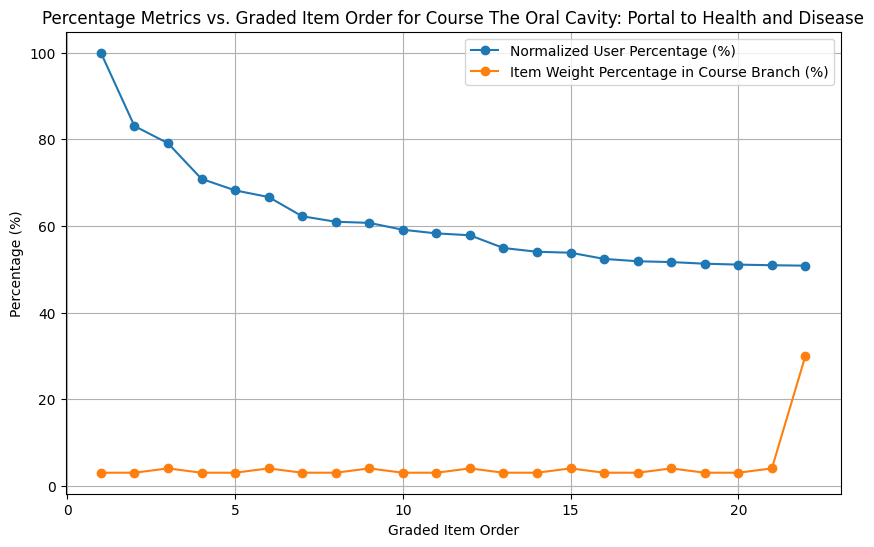

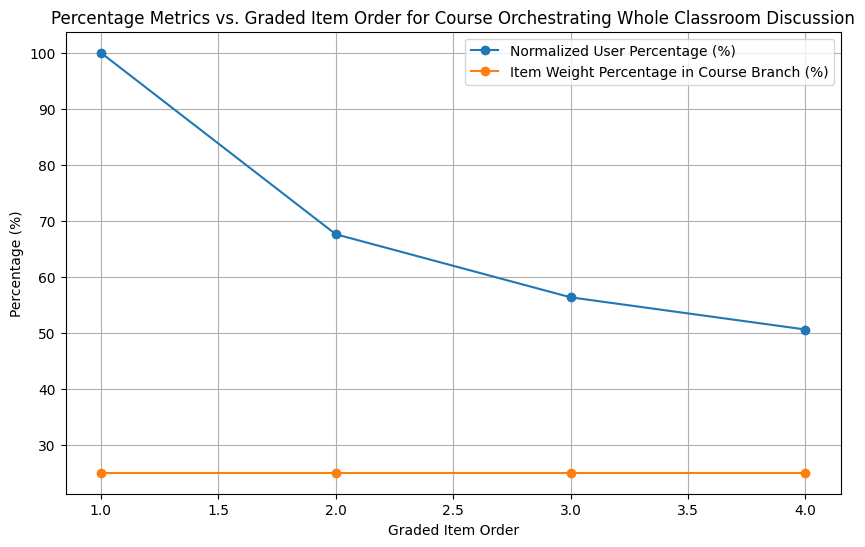

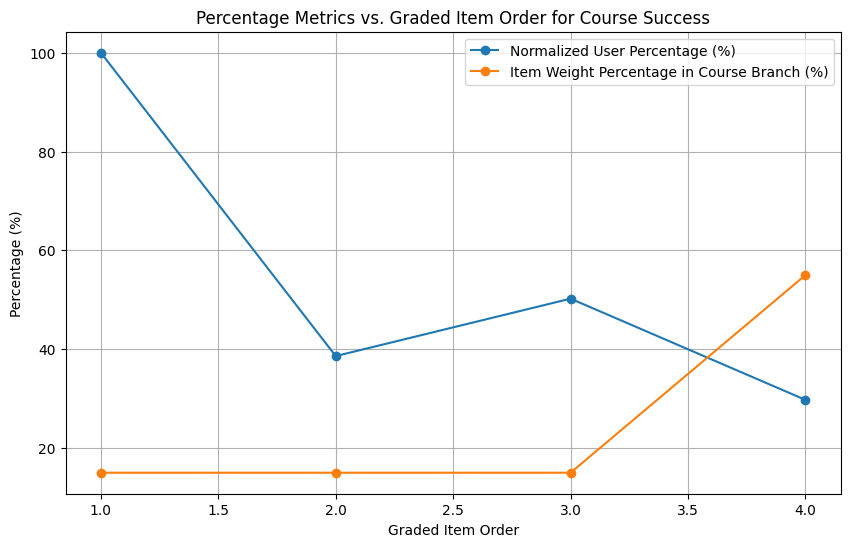

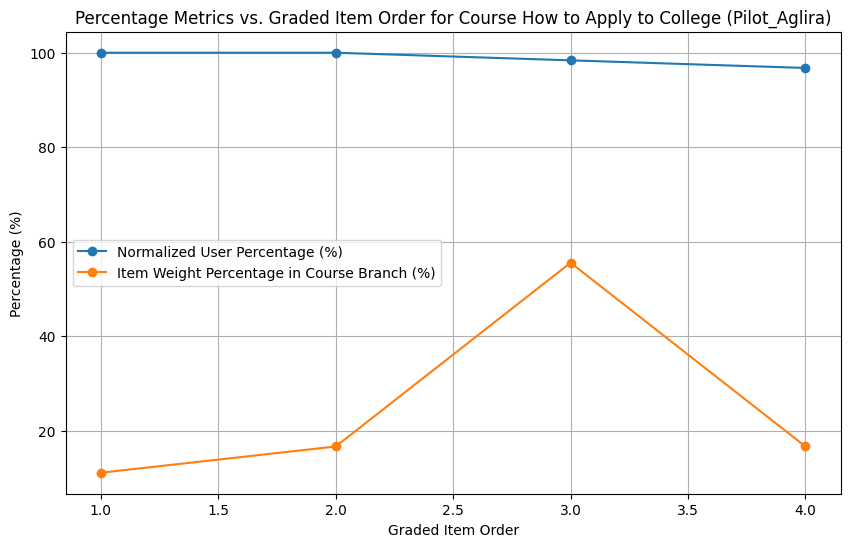

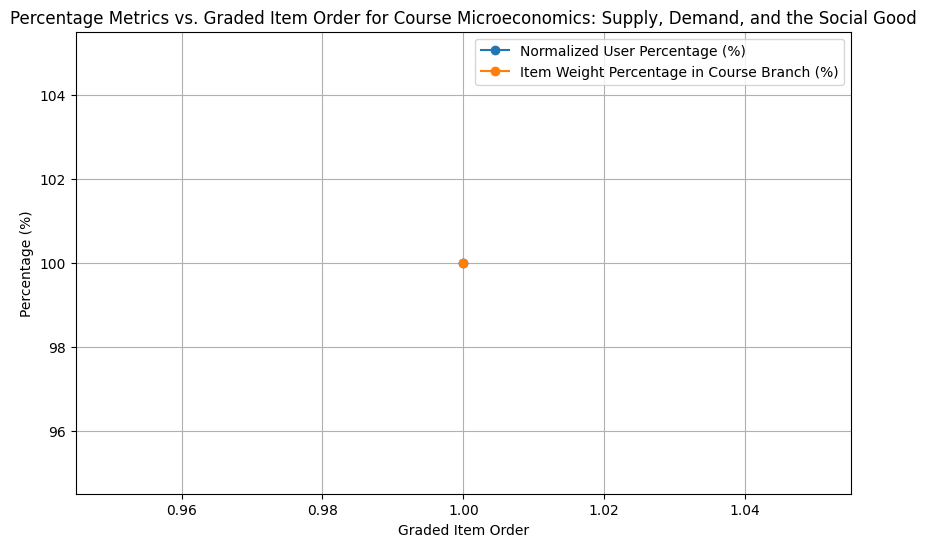

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 36816 (\N{CJK UNIFIED IDEOGRAPH-8FD0}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 33829 (\N{CJK UNIFIED IDEOGRAPH-8425}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 31649 (\N{CJK UNIFIED IDEOGRAPH-7BA1}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 29702 (\N{CJK UNIFIED IDEOGRAPH-7406}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


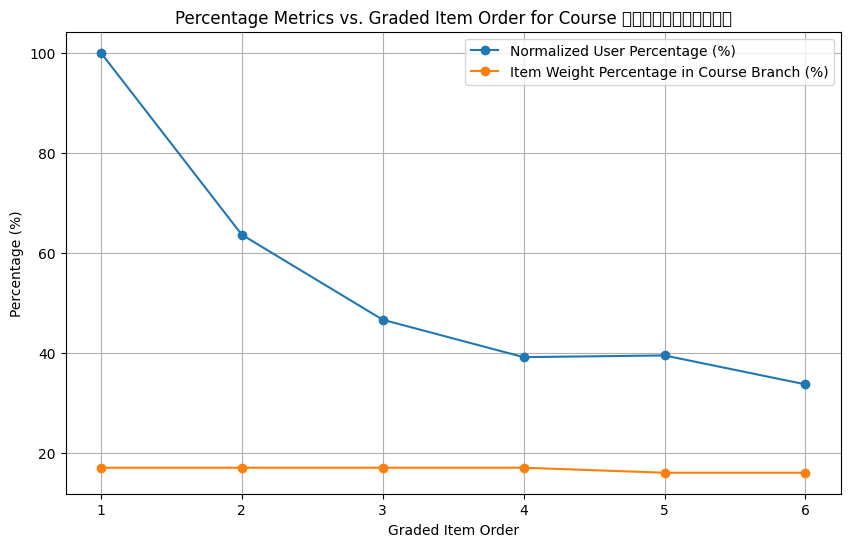

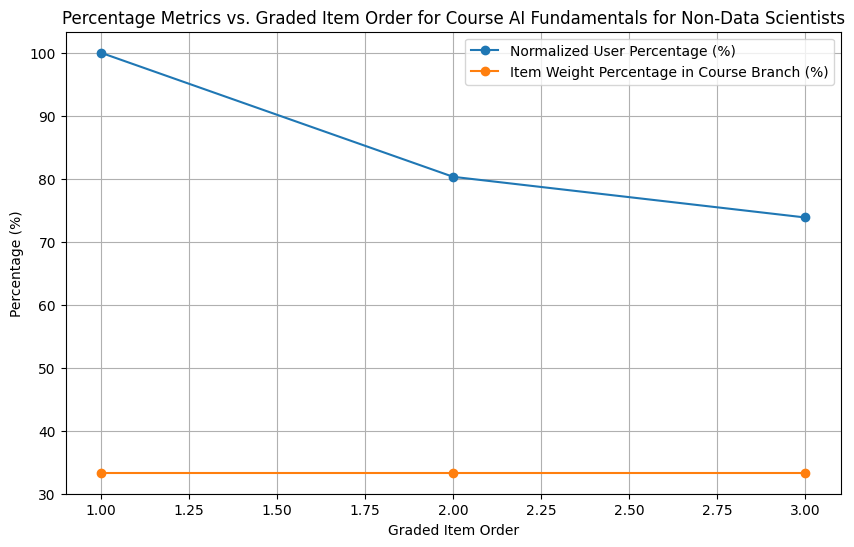

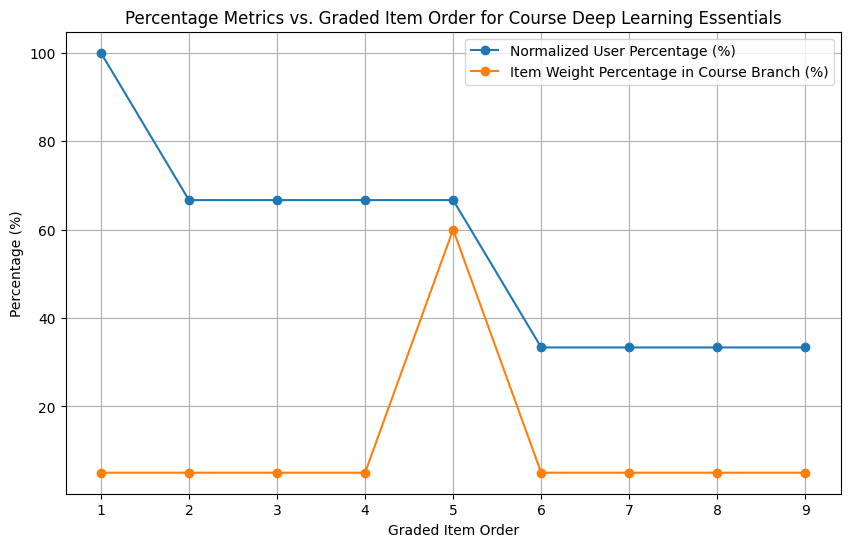

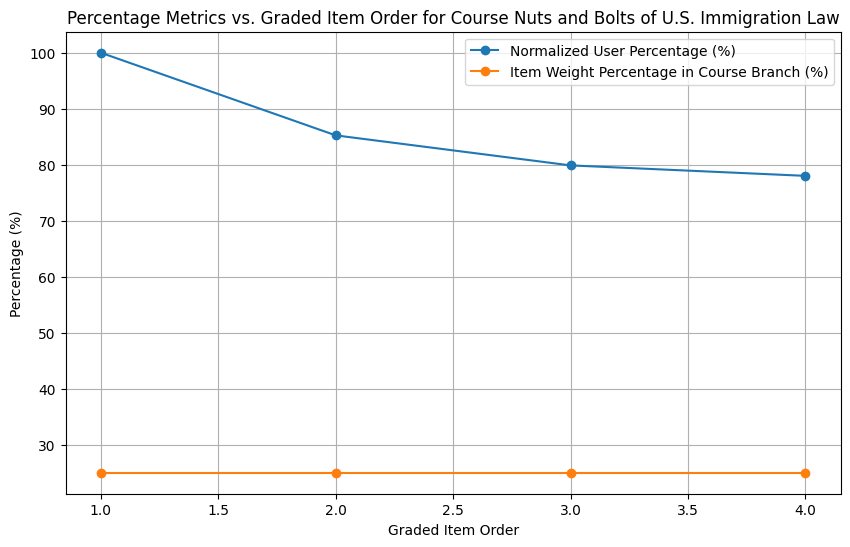

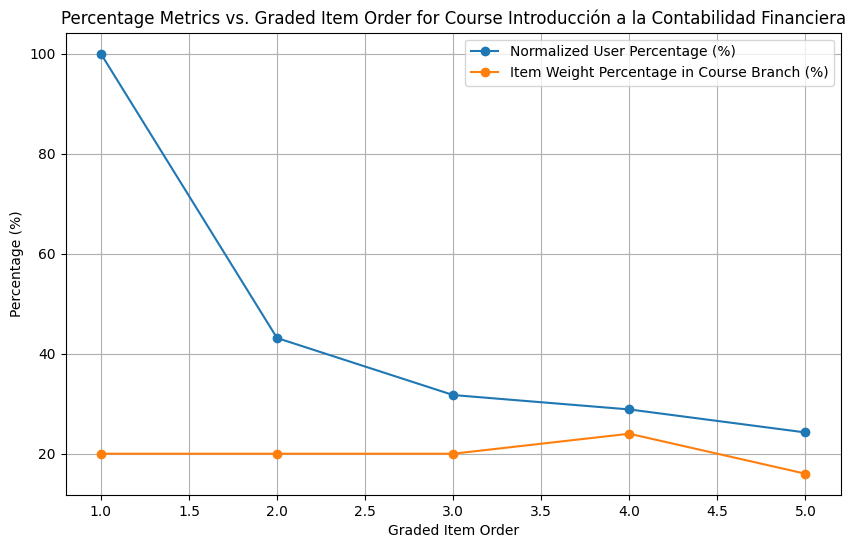

...

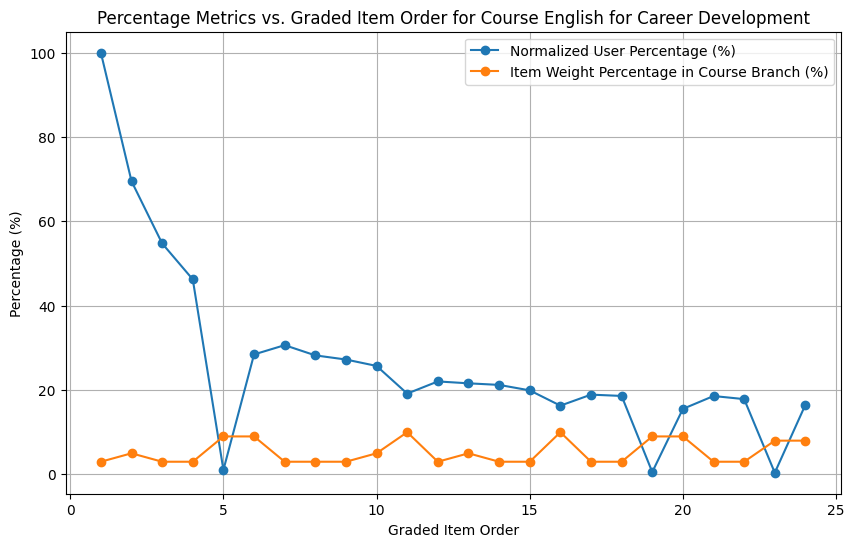

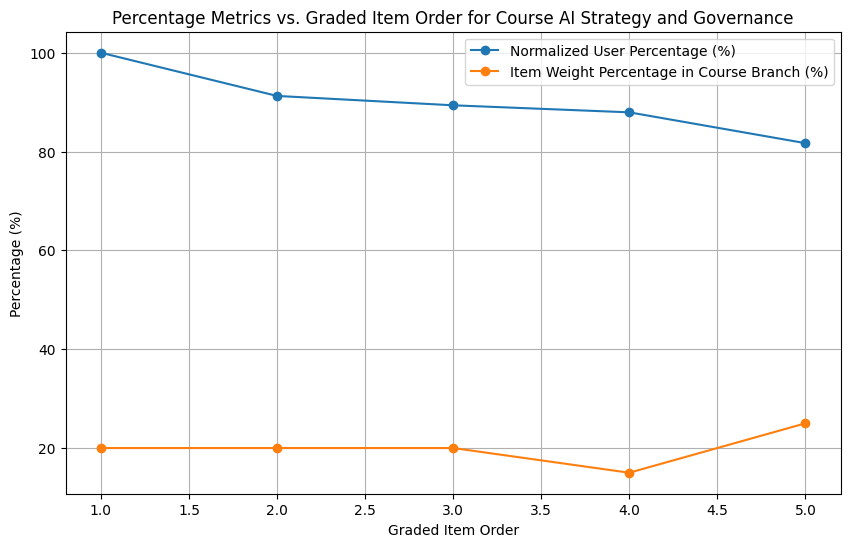

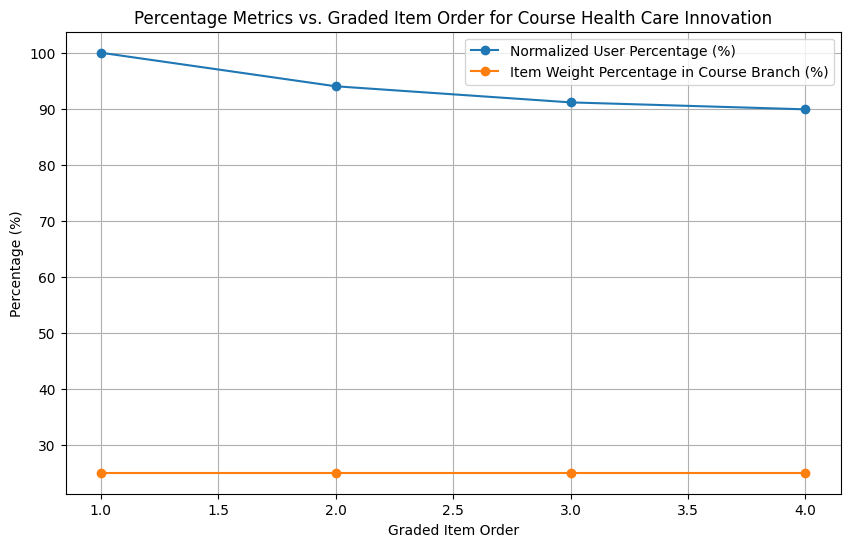

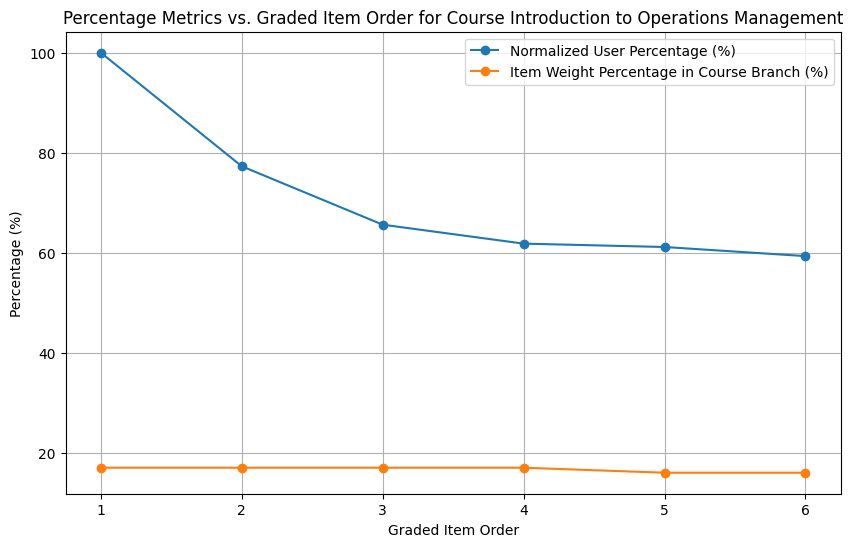

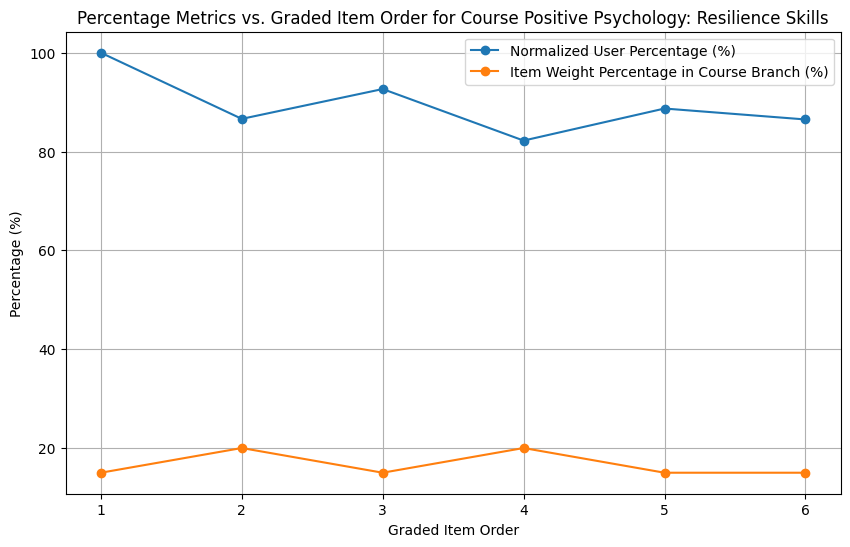

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 24066 (\N{CJK UNIFIED IDEOGRAPH-5E02}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 22330 (\N{CJK UNIFIED IDEOGRAPH-573A}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 38144 (\N{CJK UNIFIED IDEOGRAPH-9500}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)


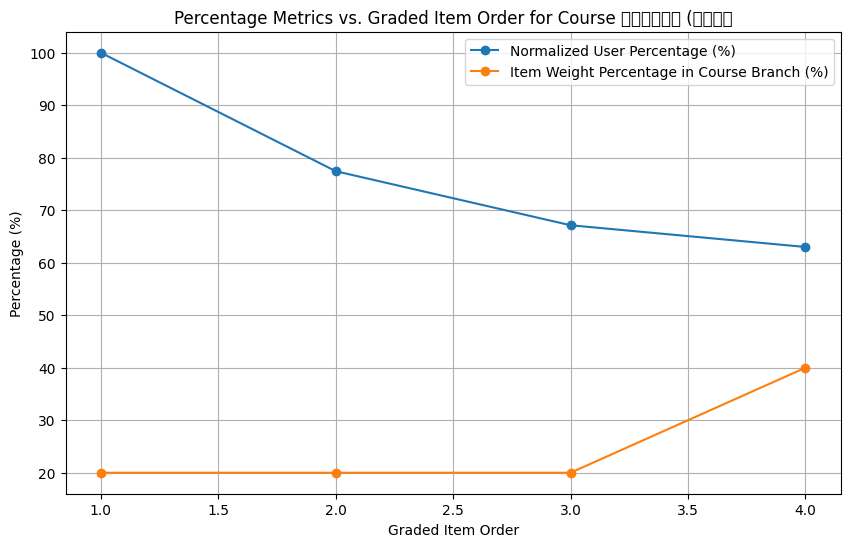

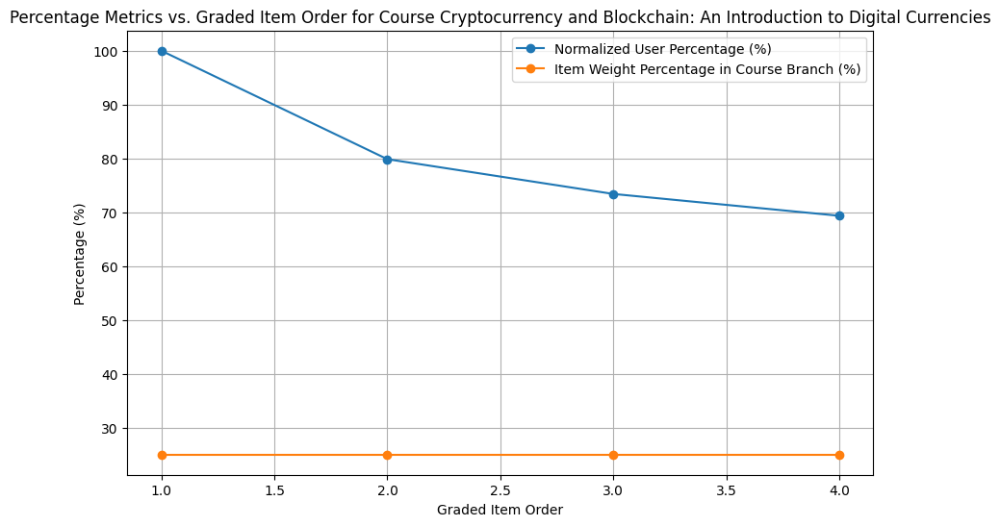

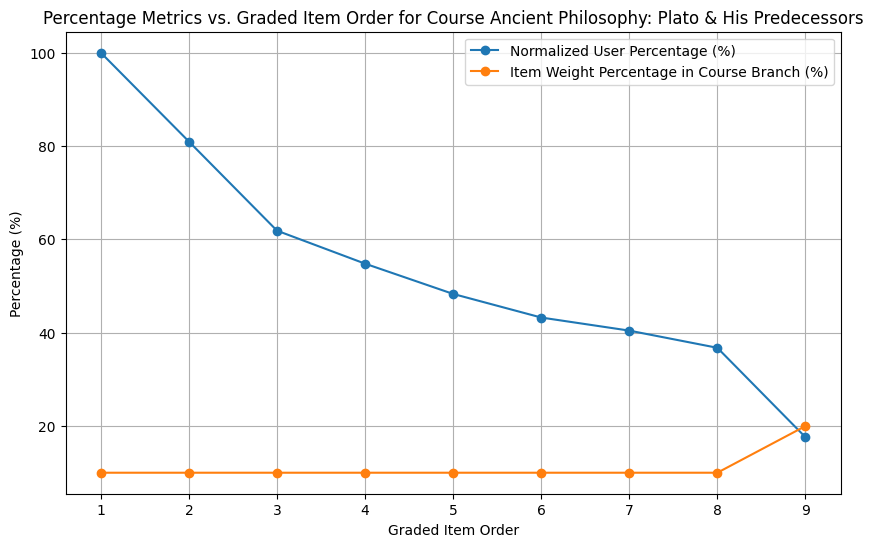

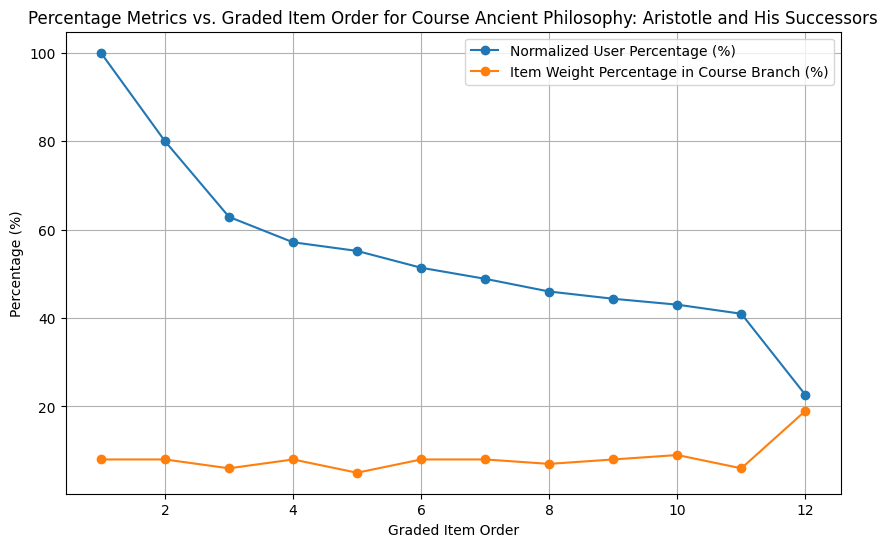

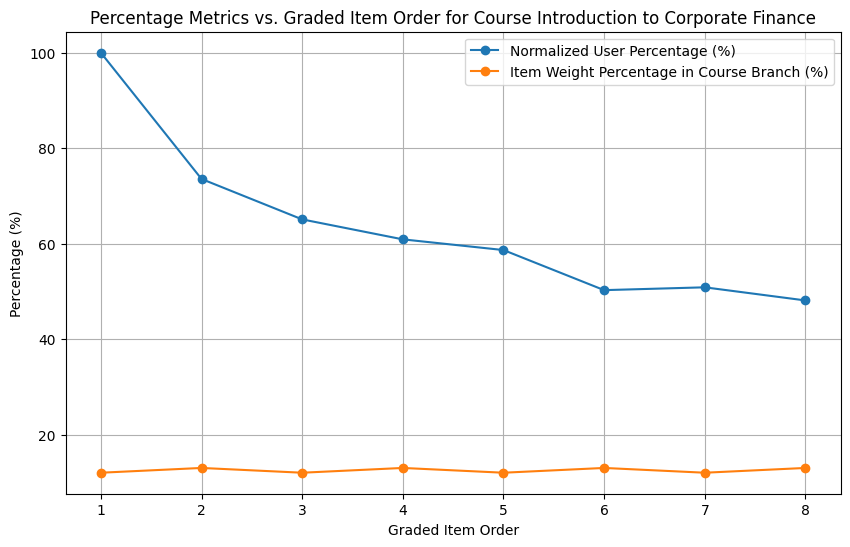

...

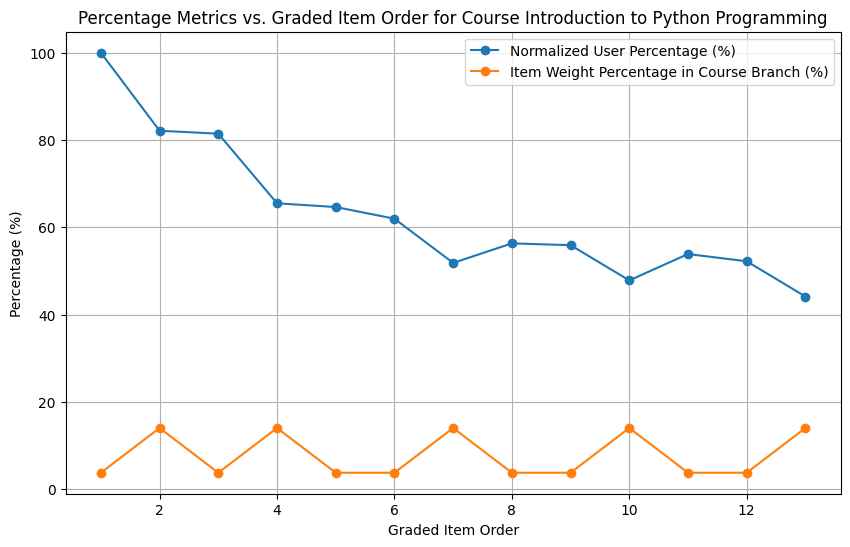

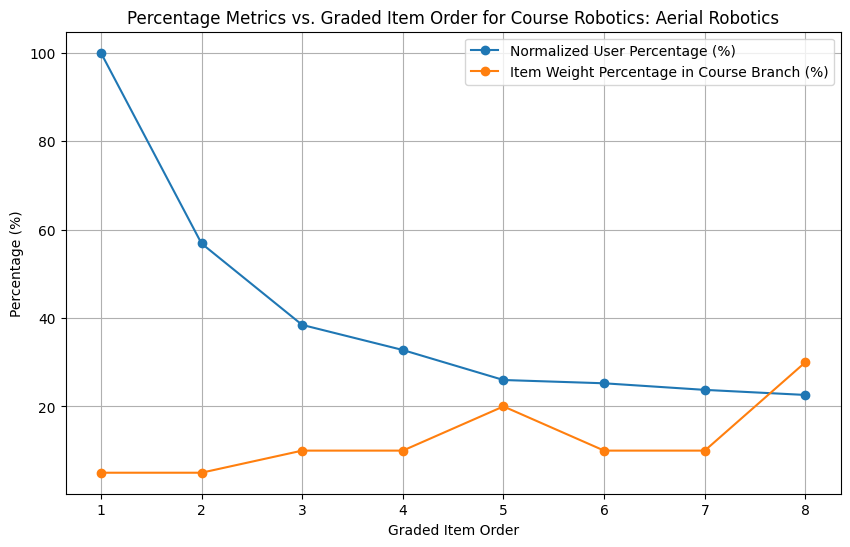

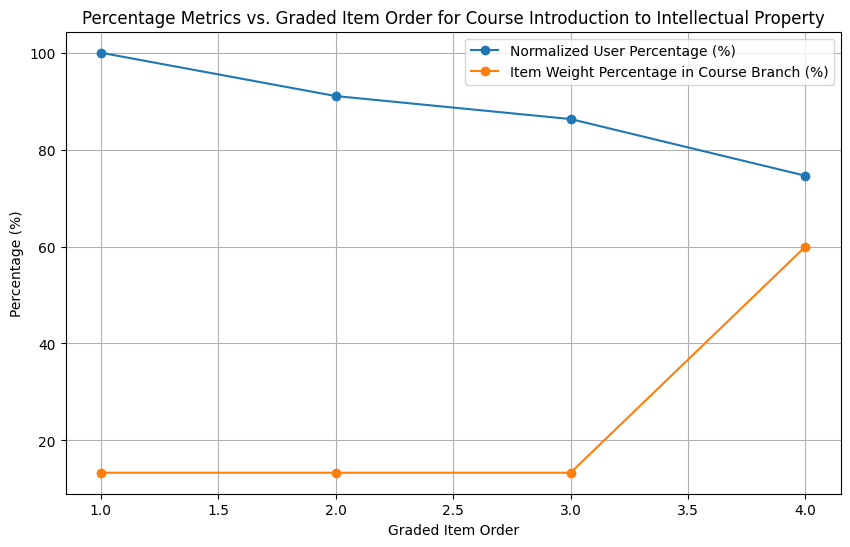

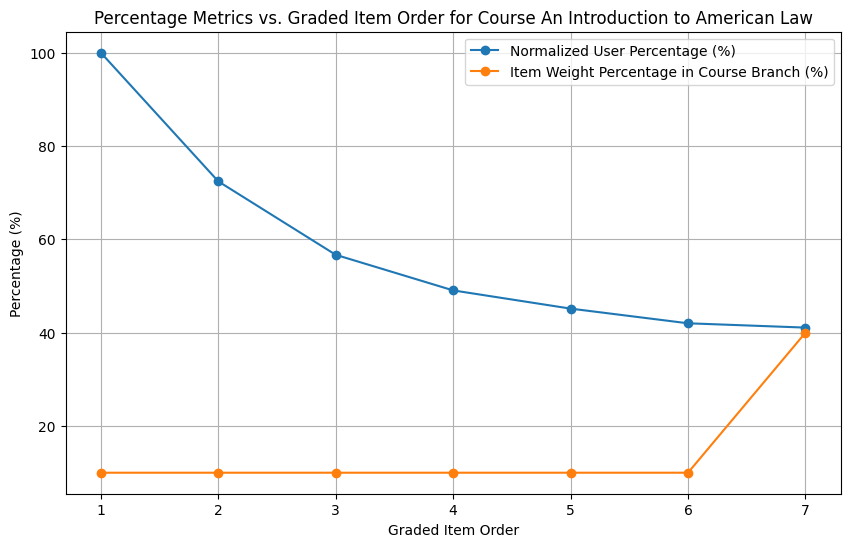

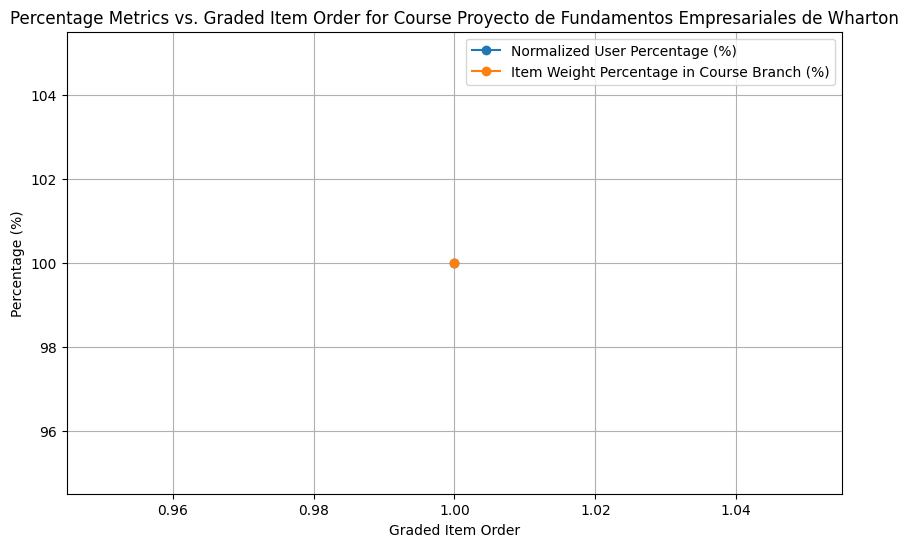

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 48708 (\N{HANGUL SYLLABLE BI}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 51592 (\N{HANGUL SYLLABLE JEU}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 45768 (\N{HANGUL SYLLABLE NI}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 50752 (\N{HANGUL SYLLABLE WA}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 49324 (\N{HANGUL SYLLABLE SA}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPyt

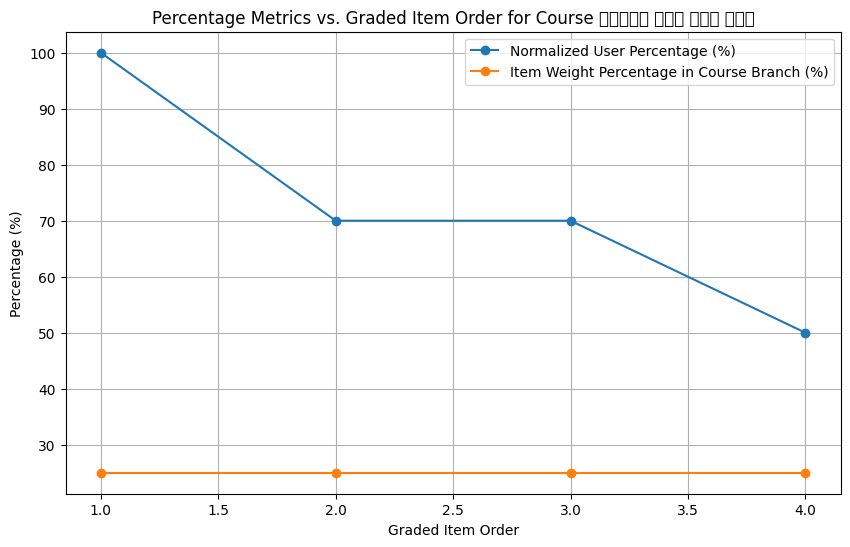

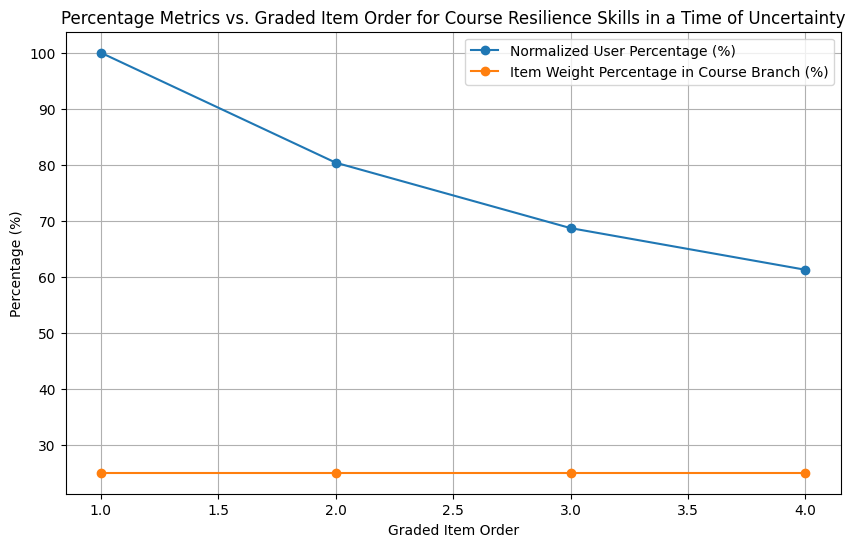

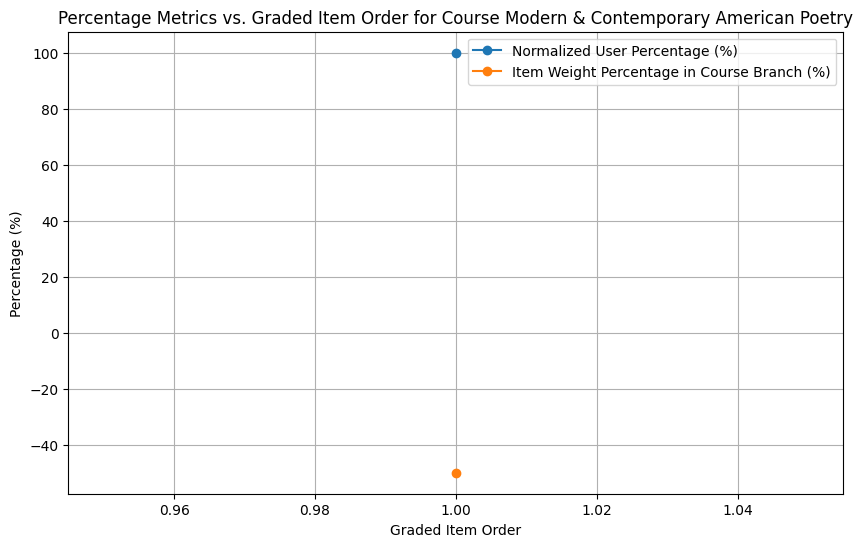

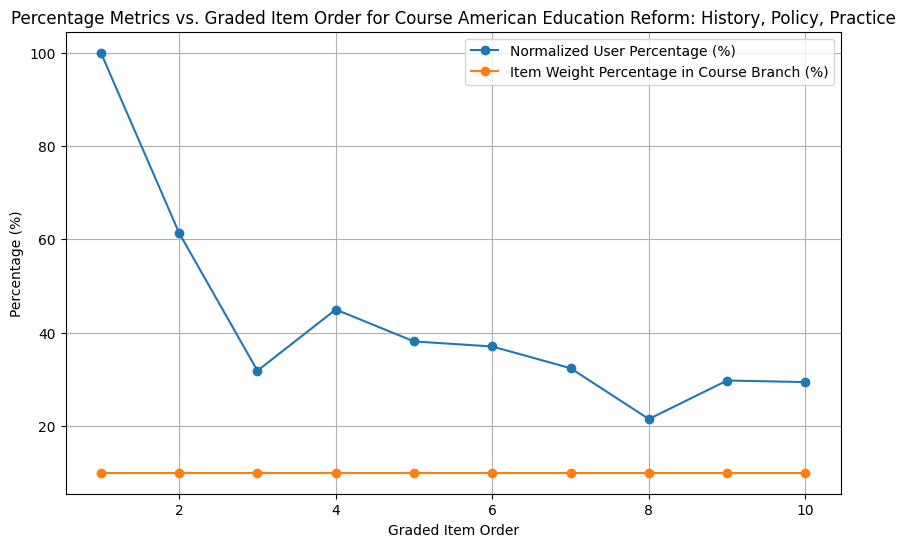

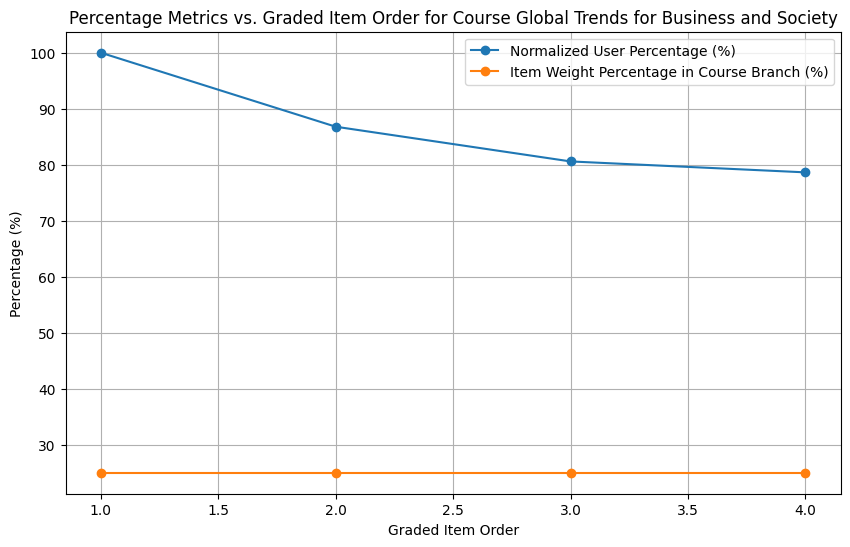

...

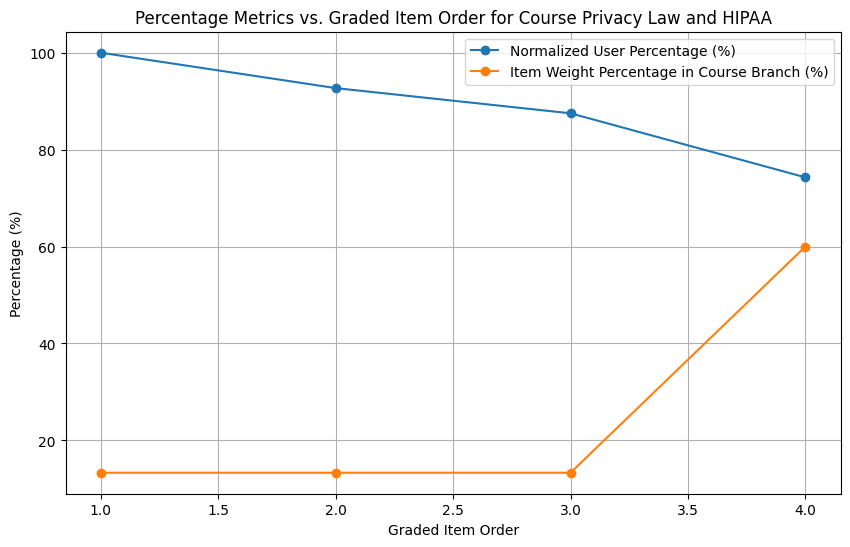

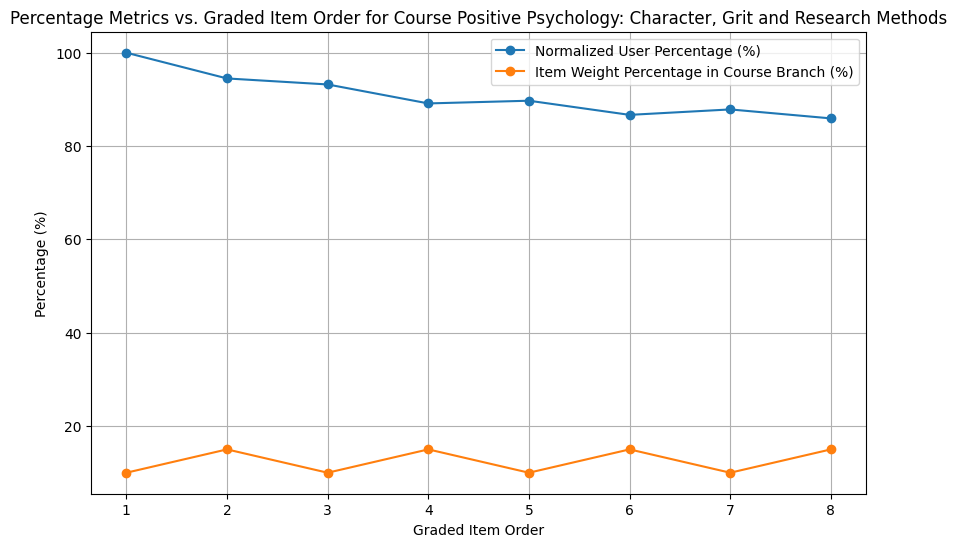

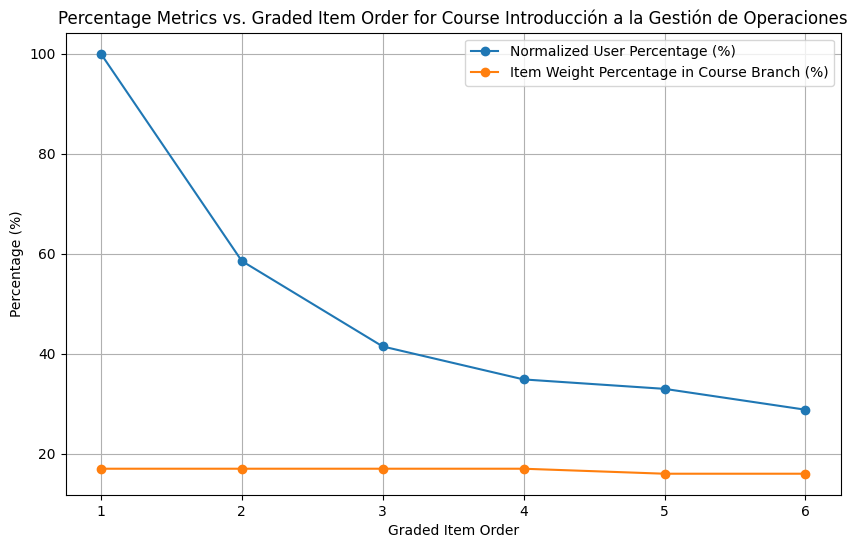

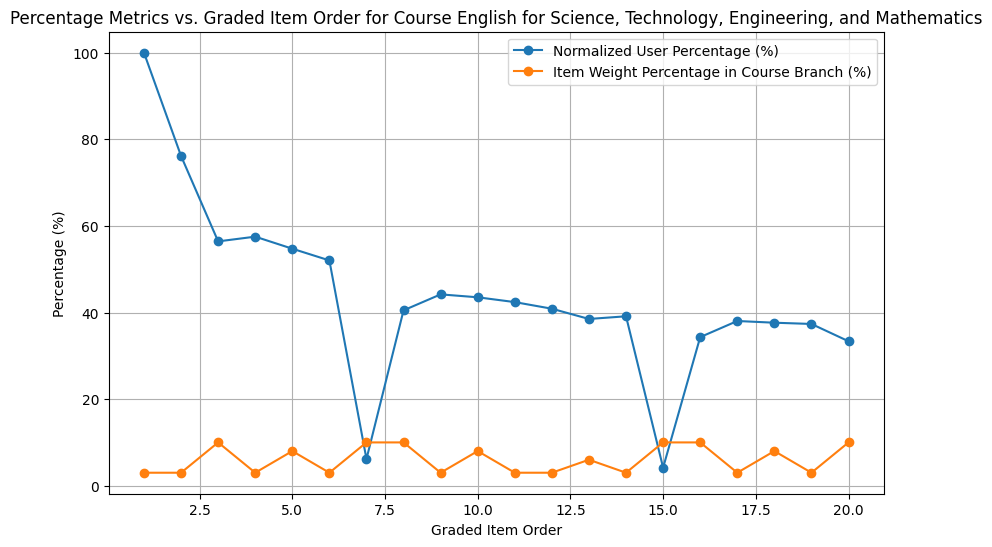

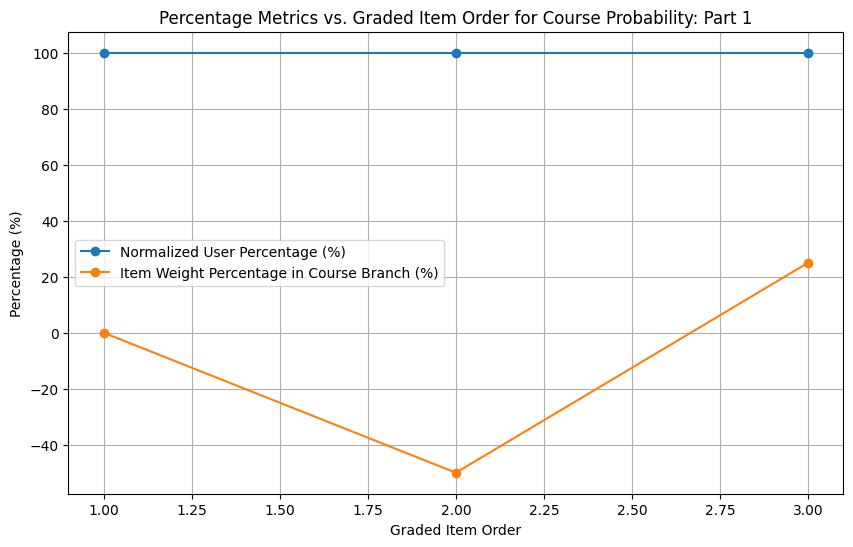

/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 51201 (\N{HANGUL SYLLABLE JEOG}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 50689 (\N{HANGUL SYLLABLE YEONG}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 54693 (\N{HANGUL SYLLABLE HYANG}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 51012 (\N{HANGUL SYLLABLE EUL}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packages/IPython/core/pylabtools.py:151: UserWarning: Glyph 50948 (\N{HANGUL SYLLABLE WI}) missing from current font.
  fig.canvas.print_figure(bytes_io, **kw)
/usr/local/lib/python3.10/dist-packa

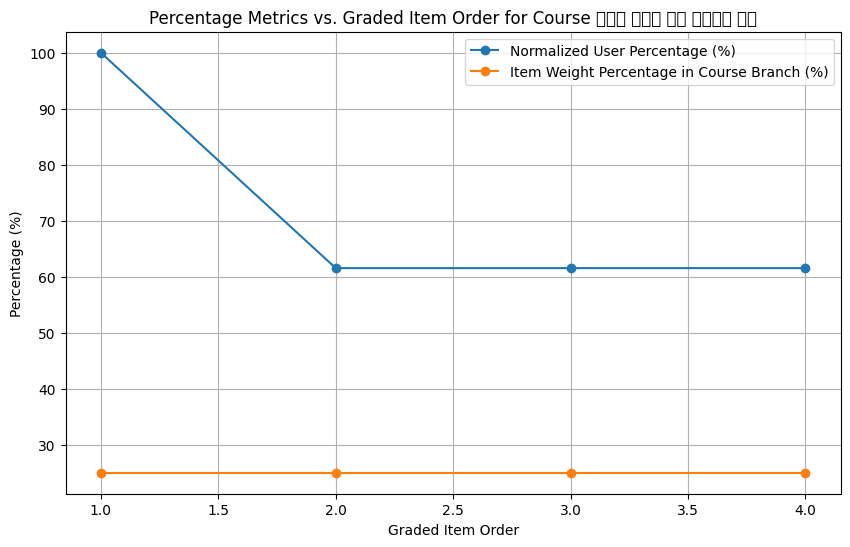

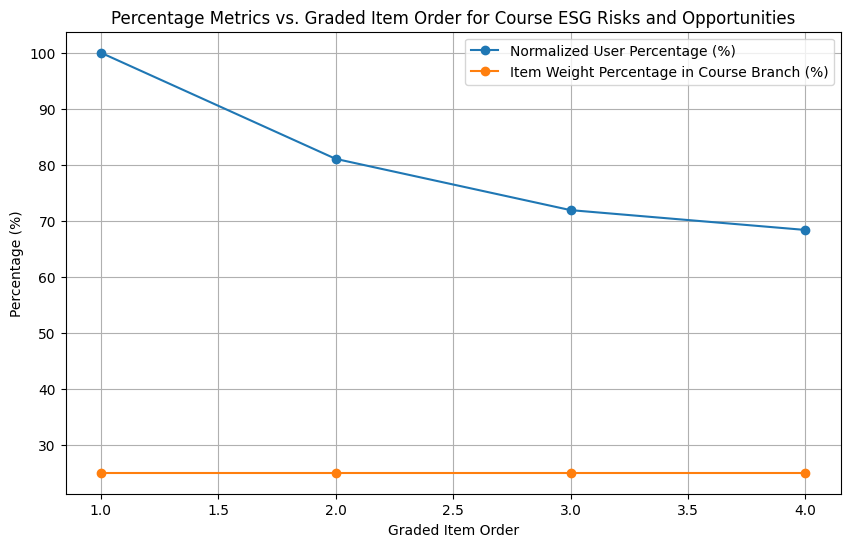

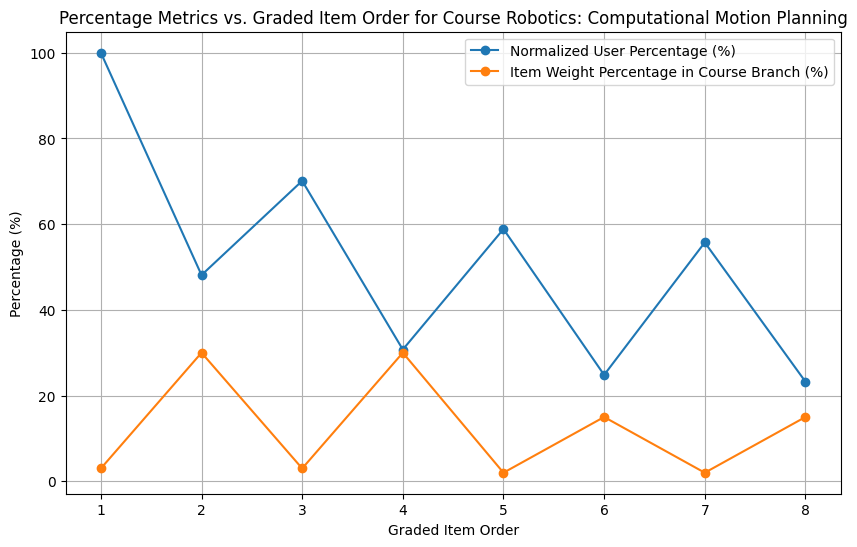

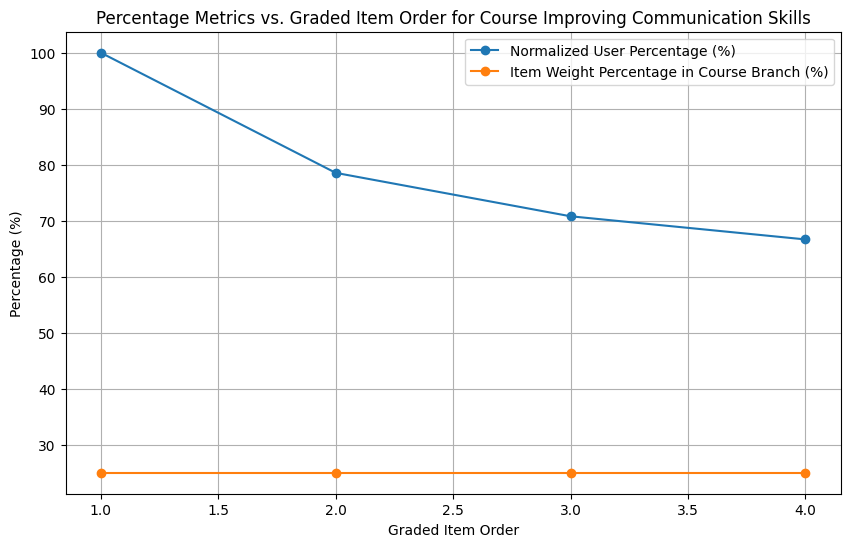

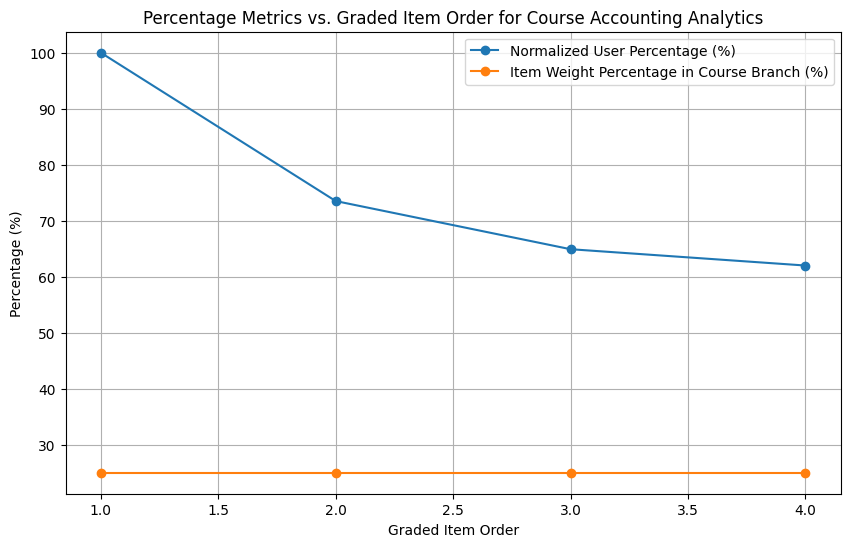

...

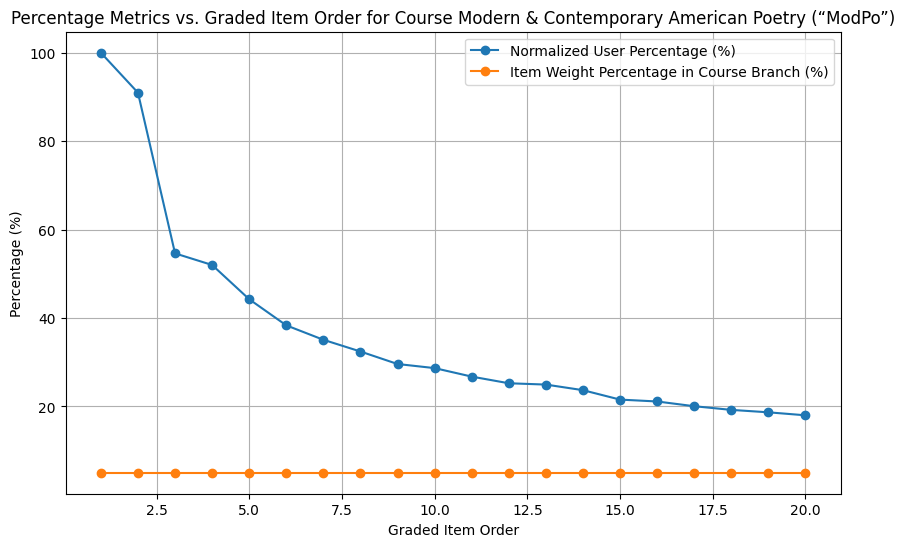

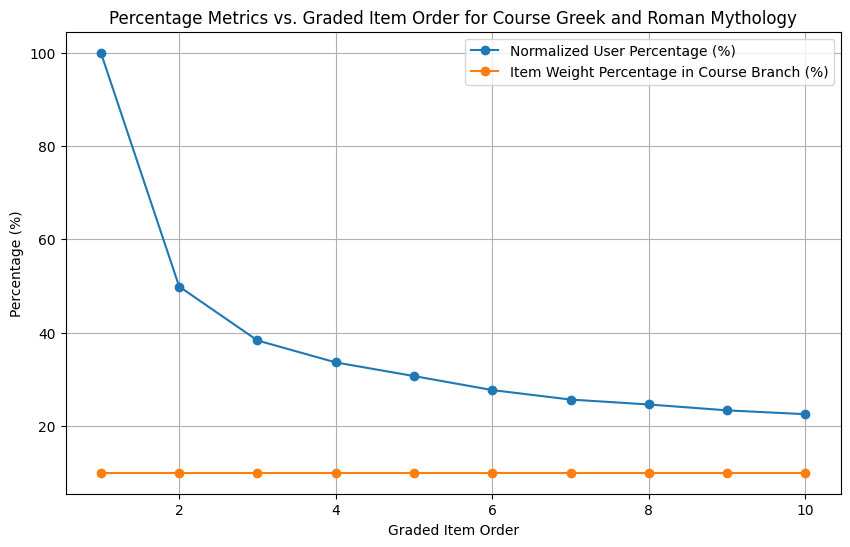

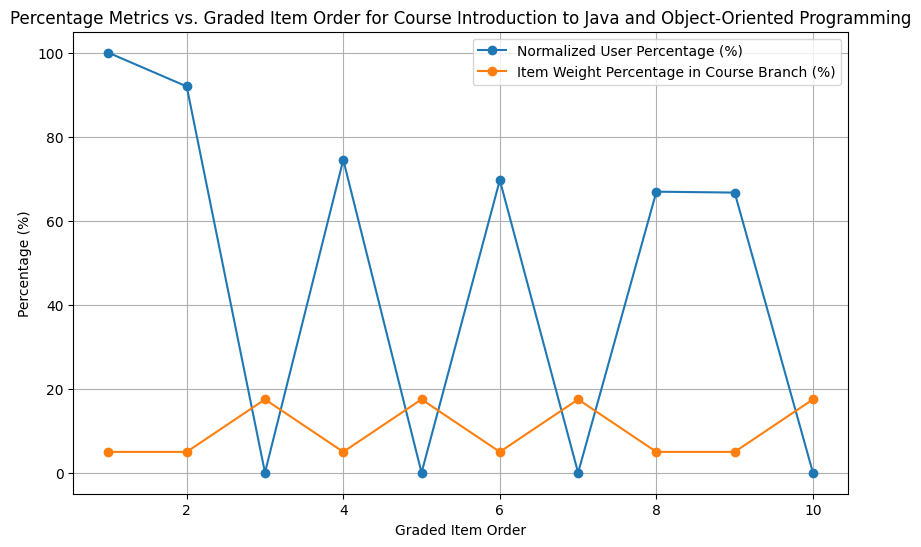

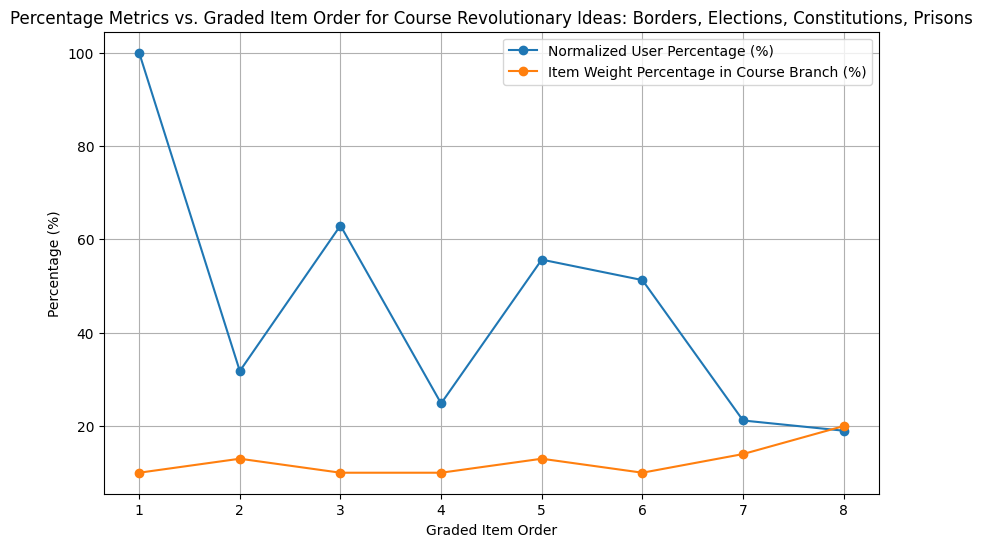

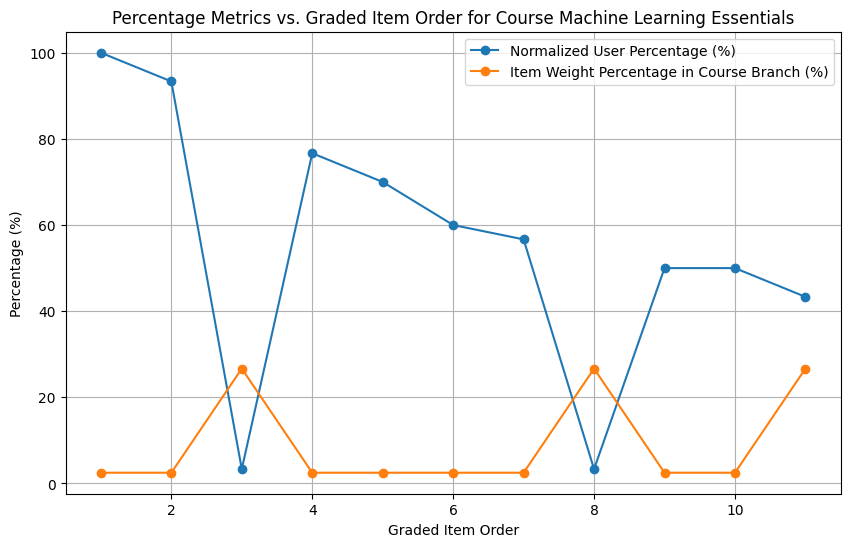

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt

# Fill NaN values in `item_weight_in_course_branch_percentage` with -50
df['item_weight_in_course_branch_percentage'].fillna(-50, inplace=True)

def plot_course_metrics(df):
    """
    Loops through all course_branch_id values and plots:
    Overlapping plots of item_weight_in_course_branch_percentage and normalized_user_percentage
    vs. graded_item_order on the same plot.

    Parameters:
        df (pd.DataFrame): The DataFrame containing the data.
    """
    # Get unique course_branch_id values
    course_branch_ids = df['course_branch_id'].unique()

    # Loop through each course_branch_id
    for course_branch_id in course_branch_ids:
        # Filter the DataFrame for the specific course_branch_id
        course_df = df[df['course_branch_id'] == course_branch_id]
        course_name = course_df['course_name'].iloc[0]

        # Sort by graded_item_order for proper plotting
        course_df = course_df.sort_values(by='graded_item_order')

        # Plot overlapping lines
        plt.figure(figsize=(10, 6))
        plt.plot(course_df['graded_item_order'], course_df['normalized_user_percentage'] * 100, marker='o', label='Normalized User Percentage (%)')
        plt.plot(course_df['graded_item_order'], course_df['item_weight_in_course_branch_percentage'], marker='o', label='Item Weight Percentage in Course Branch (%)')

        plt.title(f'Percentage Metrics vs. Graded Item Order for Course {course_name}')
        plt.xlabel('Graded Item Order')
        plt.ylabel('Percentage (%)')
        plt.grid()
        plt.legend()
        plt.show()

# Call the function to plot for all courses
plot_course_metrics(df)

## all courses dropout rate scatter plot

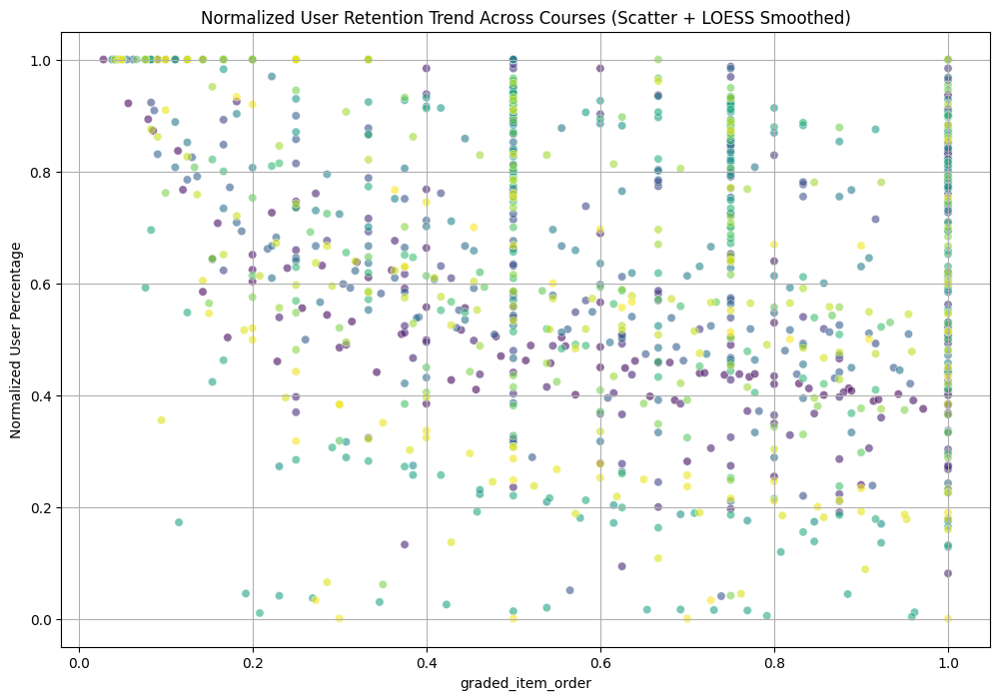

In [ ]:
# plot the course item users with respect to the ordered graded items
plt.figure(figsize=(12, 8))
sns.scatterplot(data=df, x='normalized_order', y='normalized_user_percentage', hue='course_id', palette='viridis', alpha=0.6, legend=False)
plt.title('Normalized User Retention Trend Across Courses (Scatter + LOESS Smoothed)')
plt.xlabel('graded_item_order')
plt.ylabel('Normalized User Percentage')
plt.grid()
plt.show()

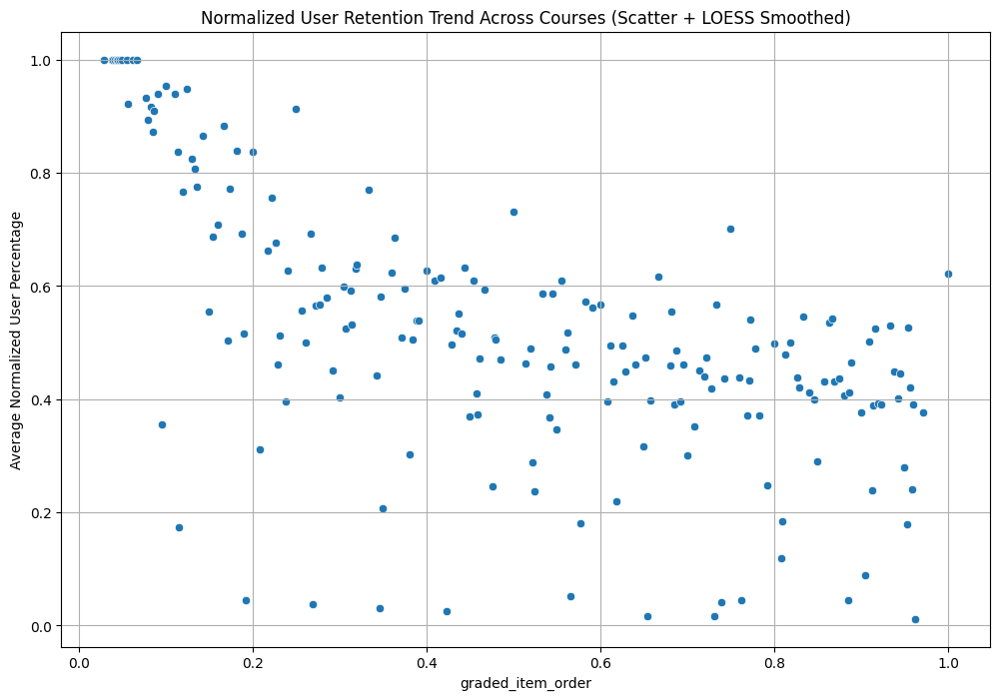

In [ ]:
normalized_trend = df.groupby('normalized_order')['normalized_user_percentage'].mean().reset_index()
plt.figure(figsize=(12, 8))
sns.scatterplot(data=normalized_trend, x='normalized_order', y='normalized_user_percentage')
plt.title('Normalized User Retention Trend Across Courses (Scatter + LOESS Smoothed)')
plt.xlabel('graded_item_order')
plt.ylabel('Average Normalized User Percentage')
plt.grid()
plt.show()

## output cleaned data

In [ ]:
df_out_path = '/content/drive/MyDrive/MOOC_Feature_Project/MOOC-Pipeline/data_preprocess_EDA/cleaned_data/cleaned_graded_item_usr_counts_1_8.csv'
df.to_csv(df_out_path, index=False)

trend_out_path = '/content/drive/MyDrive/MOOC_Feature_Project/MOOC-Pipeline/data_preprocess_EDA/cleaned_data/cleaned_averaged_usr_percent_by_items_1_8.csv'
normalized_trend.to_csv(trend_out_path, index=False)

## general dropout rate model

In [ ]:
import statsmodels.formula.api as smf

# Define the mixed-effects model formula
# Fixed effect: normalized_order
# Random effect: course_id
model = smf.mixedlm("normalized_user_percentage ~ normalized_order",
                    df,
                    groups=df["course_id"])

# Fit the model
result = model.fit()

# Print the summary of the fitted model
print(result.summary())

                 Mixed Linear Model Regression Results
Model:            MixedLM Dependent Variable: normalized_user_percentage
No. Observations: 1315    Method:             REML                      
No. Groups:       159     Scale:              0.0484                    
Min. group size:  1       Log-Likelihood:     -38.4815                  
Max. group size:  59      Converged:          Yes                       
Mean group size:  8.3                                                   
--------------------------------------------------------------------------
                     Coef.    Std.Err.      z      P>|z|   [0.025   0.975]
--------------------------------------------------------------------------
Intercept             0.849      0.023    36.576   0.000    0.804    0.894
normalized_order     -0.292      0.021   -13.709   0.000   -0.333   -0.250
Group Var             0.049      0.031                                    



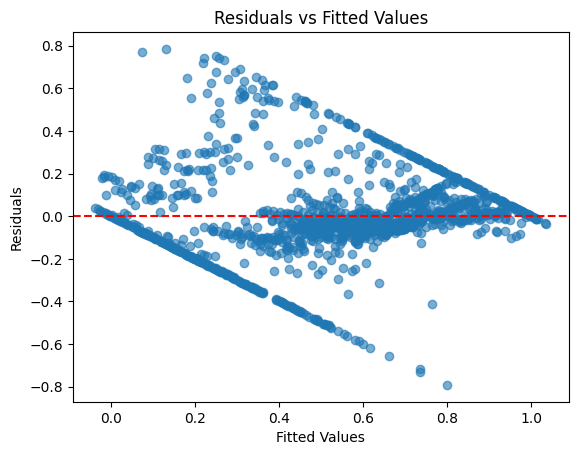

In [ ]:
# Scatter plot of residuals vs fitted values
plt.scatter(result.fittedvalues, result.resid, alpha=0.6)
plt.axhline(0, color='red', linestyle='--')
plt.xlabel("Fitted Values")
plt.ylabel("Residuals")
plt.title("Residuals vs Fitted Values")
plt.show()

In [ ]:
# Add a quadratic term to the dataset
df['normalized_order_squared'] = df['normalized_order'] ** 2

# Define the formula with quadratic term
model_formula = "normalized_user_percentage ~ normalized_order + normalized_order_squared"

# Fit the mixed-effects model with course_id as random effect
model = smf.mixedlm(model_formula, df, groups=df['course_id'])
mixed_effect_result = model.fit()

# Print model summary
print(mixed_effect_result.summary())

                 Mixed Linear Model Regression Results
Model:            MixedLM Dependent Variable: normalized_user_percentage
No. Observations: 1315    Method:             REML                      
No. Groups:       159     Scale:              0.0464                    
Min. group size:  1       Log-Likelihood:     -13.6189                  
Max. group size:  59      Converged:          Yes                       
Mean group size:  8.3                                                   
------------------------------------------------------------------------
                             Coef.  Std.Err.    z    P>|z| [0.025 0.975]
------------------------------------------------------------------------
Intercept                     0.981    0.029  33.770 0.000  0.924  1.038
normalized_order             -0.943    0.091 -10.371 0.000 -1.121 -0.765
normalized_order_squared      0.583    0.079   7.351 0.000  0.428  0.739
Group Var                     0.049    0.031                         

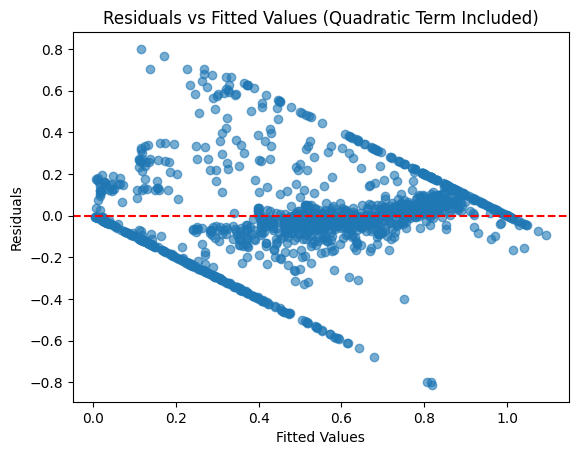

In [ ]:
# Scatter plot of residuals vs fitted values
plt.scatter(mixed_effect_result.fittedvalues, mixed_effect_result.resid, alpha=0.6)
plt.axhline(0, color='red', linestyle='--')
plt.xlabel("Fitted Values")
plt.ylabel("Residuals")
plt.title("Residuals vs Fitted Values (Quadratic Term Included)")
plt.show()

In [ ]:
from sklearn.model_selection import KFold
from sklearn.metrics import r2_score
import numpy as np
from statsmodels.formula.api import mixedlm

# Define 5-Fold Cross-Validation
kf = KFold(n_splits=5, shuffle=True, random_state=42)

# Lists to store R² scores for both models
r2_scores_single_term = []
r2_scores_quadratic_term = []

# Perform 5-Fold Cross-Validation
for train_index, test_index in kf.split(df):
    train_data = df.iloc[train_index]
    test_data = df.iloc[test_index]

    # --- Model 1: Single fixed effect (normalized_order) ---
    model_single_term = mixedlm("normalized_user_percentage ~ normalized_order",
                                train_data,
                                groups=train_data["course_id"])
    result_single_term = model_single_term.fit()

    y_pred_single = result_single_term.predict(test_data)
    y_true_single = test_data["normalized_user_percentage"]
    r2_single = r2_score(y_true_single, y_pred_single)
    r2_scores_single_term.append(r2_single)

    # --- Model 2: Quadratic term (normalized_order + normalized_order²) ---
    train_data['normalized_order_squared'] = train_data['normalized_order'] ** 2
    test_data['normalized_order_squared'] = test_data['normalized_order'] ** 2

    model_quadratic_term = mixedlm("normalized_user_percentage ~ normalized_order + normalized_order_squared",
                                   train_data,
                                   groups=train_data["course_id"])
    result_quadratic_term = model_quadratic_term.fit()

    y_pred_quad = result_quadratic_term.predict(test_data)
    r2_quad = r2_score(y_true_single, y_pred_quad)
    r2_scores_quadratic_term.append(r2_quad)

# Average R² scores across all folds
average_r2_single = np.mean(r2_scores_single_term)
average_r2_quadratic = np.mean(r2_scores_quadratic_term)

# Print results
print(f"Average R² Score for Single Term Model (normalized_order): {average_r2_single:.4f}")
print(f"Average R² Score for Quadratic Term Model (normalized_order + normalized_order²): {average_r2_quadratic:.4f}")

<ipython-input-10-29cfa711d33e>:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  train_data['normalized_order_squared'] = train_data['normalized_order'] ** 2
<ipython-input-10-29cfa711d33e>:31: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  test_data['normalized_order_squared'] = test_data['normalized_order'] ** 2
<ipython-input-10-29cfa711d33e>:30: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the cav

Average R² Score for Single Term Model (normalized_order): -0.1800
Average R² Score for Quadratic Term Model (normalized_order + normalized_order²): -0.1649


# assessments eda

In [ ]:
assessment_df = pd.read_csv('/content/drive/MyDrive/MOOC_Feature_Project/MOOC-Pipeline/data_preprocess_EDA/raw_data/sql_assessments_1_17.csv')
assessment_df.shape

(73495, 25)

In [ ]:
assessment_df.columns

Index(['course_branch_id', 'course_item_id', 'course_branch_item_name',
       'is_graded', 'quiz_assessment_id', 'quiz_is_graded',
       'assessment_type_desc', 'assessment_passing_fraction',
       'assessment_feedback_configuration', 'assessment_question_id',
       'assessment_question_cuepoint', 'assessment_question_order',
       'assessment_question_weight', 'assessment_question_extra_credit',
       'assessment_question_type_desc', 'assessment_question_prompt',
       'assessment_option_id', 'assessment_option_display',
       'assessment_option_feedback', 'assessment_option_correct',
       'assessment_option_index', 'global_item_id', 'global_item_name',
       'global_item_content_type', 'global_item_time_commitment'],
      dtype='object')

In [ ]:
print(assessment_df.is_graded.value_counts())
print(assessment_df.quiz_is_graded.value_counts())
print(assessment_df.assessment_type_desc.value_counts())
print(assessment_df.assessment_feedback_configuration.value_counts())
print(assessment_df.assessment_question_cuepoint.value_counts())
print(assessment_df.assessment_question_type_desc.value_counts())
print(assessment_df.assessment_option_feedback.value_counts())

is_graded
True     44414
False    29081
Name: count, dtype: int64
quiz_is_graded
True     42950
False     9257
Name: count, dtype: int64
assessment_type_desc
summative    42950
formative     9257
Name: count, dtype: int64
assessment_feedback_configuration
Explained     25271
Graded        15690
NoFeedback       32
Name: count, dtype: int64
assessment_question_cuepoint
0.0    52207
Name: count, dtype: int64
assessment_question_type_desc
mcq                 41375
checkbox             7932
mcqReflect           1748
single numeric        392
reflect               330
checkboxReflect       221
text exact match      172
math expression        17
codeExpression         17
regex                   1
Name: count, dtype: int64
assessment_option_feedback
{"typeName":"cml","definition":{"dtdId":"assess/1","value":"<co-content></co-content>"}}                                                                                                                                                               

In [ ]:
result = assessment_df.groupby('assessment_question_type_desc')['assessment_question_prompt'].first().reset_index()

for index, row in result.iterrows():
    print(f"Assessment Question Type: {row['assessment_question_type_desc']}")
    print(result.assessment_question_prompt.iloc[index])

Assessment Question Type: checkbox
{"typeName":"cml","definition":{"dtdId":"assess/1","value":"<co-content><text hasMath=\"true\">You are given two (distinguishable) dice; identify them as $$A$$ and $$B$$.  Die $$A$$ has three red faces and five white faces while die $$B$$ has five red faces and three white faces.  You flip a fair coin once.  If it shows heads then you pick die $$A$$ and throw it once.  If, however, the coin shows up tails then you pick die $$B$$ and throw it once.  Which of the following options completely characterises a sample point (that is to say, an outcome) of the sample space in this chance experiment?</text></co-content>"}}
Assessment Question Type: checkboxReflect
{"typeName":"cml","definition":{"dtdId":"assess/1","value":"<co-content><text>Academically, what motivates you?  Select the<strong> *two*</strong> most important motivating factors in your academics.    </text></co-content>"}}
Assessment Question Type: codeExpression
{"typeName":"cml","definition":{

In [ ]:
above_df = pd.read_csv('/content/drive/MyDrive/MOOC_Feature_Project/MOOC-Pipeline/data_preprocess_EDA/cleaned_data/cleaned_graded_item_above_CI.csv')
below_df = pd.read_csv('/content/drive/MyDrive/MOOC_Feature_Project/MOOC-Pipeline/data_preprocess_EDA/cleaned_data/cleaned_graded_item_below_CI.csv')

In [ ]:
print(above_df.shape)
print(below_df.shape)

(312, 27)
(30, 27)


In [ ]:
above_merge_df = pd.merge(above_df, assessment_df, on=['course_branch_id', 'course_item_id'], how='inner')
below_merge_df = pd.merge(below_df, assessment_df, on=['course_branch_id', 'course_item_id'], how='inner')
print(above_merge_df.shape)
print(below_merge_df.shape)

(6395, 50)
(30, 50)


In [ ]:
above_merge_df.columns

Index(['course_id', 'course_slug', 'course_name', 'course_branch_id',
       'course_module_id', 'course_branch_module_order', 'course_lesson_id',
       'course_branch_lesson_order', 'course_item_id',
       'course_branch_item_name_x', 'course_branch_item_order', 'is_graded_x',
       'course_branch_item_optional', 'course_branch_item_lecture_duration_ms',
       'quiz_is_graded_x', 'item_weight_in_course_branch_percentage',
       'unique_user_count', 'graded_item_order', 'max_users_per_course',
       'normalized_user_percentage', 'max_order', 'normalized_order',
       'normalized_order_squared', 'predicted_normalized_user_percentage',
       'lower_bound', 'upper_bound', 'outlier_status',
       'course_branch_item_name_y', 'is_graded_y', 'quiz_assessment_id',
       'quiz_is_graded_y', 'assessment_type_desc',
       'assessment_passing_fraction', 'assessment_feedback_configuration',
       'assessment_question_id', 'assessment_question_cuepoint',
       'assessment_question_orde

In [ ]:
above_merge_df.assessment_feedback_configuration.unique()

array([nan, 'Explained', 'Graded'], dtype=object)

In [ ]:
print(above_merge_df.assessment_type_desc.value_counts())
print(below_merge_df.assessment_type_desc.value_counts())
print(above_merge_df.assessment_question_type_desc.value_counts())
print(below_merge_df.assessment_question_type_desc.value_counts())
print(above_merge_df.global_item_content_type.value_counts())
print(below_merge_df.global_item_content_type.value_counts())

assessment_type_desc
summative    6262
Name: count, dtype: int64
Series([], Name: count, dtype: int64)
assessment_question_type_desc
mcq                 5329
checkbox             657
mcqReflect           220
reflect               34
single numeric        14
text exact match       7
math expression        1
Name: count, dtype: int64
Series([], Name: count, dtype: int64)
global_item_content_type
quiz                     6262
staffGraded                89
peerReview                 38
ltiTool                     3
programmingAssignment       2
placeholder                 1
Name: count, dtype: int64
global_item_content_type
staffGraded              15
ltiTool                  10
peerReview                4
programmingAssignment     1
Name: count, dtype: int64


In [ ]:
below_merge_df.isna().sum()

,0
course_id,0
course_slug,0
course_name,0
course_branch_id,0
course_module_id,0
course_branch_module_order,0
course_lesson_id,0
course_branch_lesson_order,0
course_item_id,0
course_branch_item_name_x,0


# real dropout

In [ ]:
# data read in
course_item_grades = pd.read_csv('/content/drive/MyDrive/MOOC_Feature_Project/MOOC-Pipeline/data_preprocess_EDA/raw_data/sql_course_item_grades_1_21.csv')
course_items = pd.read_csv('/content/drive/MyDrive/MOOC_Feature_Project/MOOC-Pipeline/data_preprocess_EDA/raw_data/sql_course_branch_item_user_trend_1_8.csv')

In [ ]:
# filter graded items and print the shape pre and post filtering
graded_items = course_items[course_items['is_graded'] == True]
print(graded_items.shape)
print(course_items.shape)

(2718, 17)
(22487, 17)


In [ ]:
# itentify courses with branch changes order of course items
a = graded_items.groupby(['course_id', 'course_item_id']).agg({
    'course_branch_module_order': 'nunique',
    'course_branch_lesson_order': 'nunique',
    'course_branch_item_order': 'nunique'
}).reset_index()

# Remove rows where any of the three nunique values is greater than 1
filtered_a = a[((a['course_branch_module_order'] > 1) |
                 (a['course_branch_lesson_order'] > 1) |
                 (a['course_branch_item_order'] > 1))]

In [ ]:
# exclude course items in courses that have branches updates changing its order, 19 courses with 127 items
graded_items_clean = graded_items[~graded_items['course_id'].isin(filtered_a.course_id.unique())]
item_order = graded_items_clean[['course_id', 'course_item_id', 'course_branch_module_order', 'course_branch_lesson_order', 'course_branch_item_order']].drop_duplicates()
item_order = item_order.sort_values(by=['course_id', 'course_branch_module_order', 'course_branch_lesson_order', 'course_branch_item_order'])
item_order['graded_item_order'] = item_order.groupby(['course_id']).cumcount() + 1
item_order['num_of_items'] = item_order.groupby(['course_id'])['course_item_id'].transform('count')

In [ ]:
# merge item order and num items back to course item grades
course_item_grades = course_item_grades.merge(
    item_order[['course_id', 'course_item_id', 'graded_item_order', 'num_of_items']],
    on=['course_id', 'course_item_id'],
    how='left'
)

# drop grades on courses branch updates that changed order of items, about 20 percent of grades
course_item_grades = course_item_grades.dropna(subset=['graded_item_order'])

In [ ]:
# check the last item each student done
last_item_per_student = course_item_grades.groupby(['course_id', 'penn_user_id'])['graded_item_order'].max().reset_index()
last_item_per_student = last_item_per_student.rename(columns={'graded_item_order': 'last_item_order'})

# merge last item df back to course_item grades
course_item_grades = course_item_grades.merge(
    last_item_per_student,
    on=['course_id', 'penn_user_id']
)

course_item_grades['dropout_item_id'] = course_item_grades.apply(
    lambda row: None if row['last_item_order'] == row['num_of_items']
    else row['course_item_id'] if row['graded_item_order'] == row['last_item_order'] else None,
    axis=1
)

# do the dropout count for each course items
dropout_count = course_item_grades[~course_item_grades['dropout_item_id'].isna()] \
.groupby(['course_id', 'dropout_item_id'])['penn_user_id'].nunique().reset_index(name='dropout_count')

# calculate the total count of student in a course
total_count = course_item_grades.groupby(['course_id'])['penn_user_id'].nunique().reset_index(name='total_count')

# merge two dfs for dropout percentage
dropout_percentage = dropout_count.merge(total_count, on='course_id')

# calculate dropout percentage
dropout_percentage['dropout_percentage'] = dropout_percentage['dropout_count'] / dropout_percentage['total_count']

In [ ]:
# create teh dropout percentage df for each graded course items
graded_item_dropout_df = item_order.merge(
    dropout_percentage[['course_id', 'dropout_item_id','dropout_count', 'total_count', 'dropout_percentage']],
    left_on=['course_id','course_item_id'],
    right_on=['course_id', 'dropout_item_id'],
    how='left'
)

graded_item_dropout_df['dropout_percentage'] = graded_item_dropout_df['dropout_percentage'].fillna(0)

# sanity check for total dropout_percentage not exceed 1
print(max(graded_item_dropout_df.groupby('course_id')['dropout_percentage'].sum()))

1.0


## graded items dropout visualization

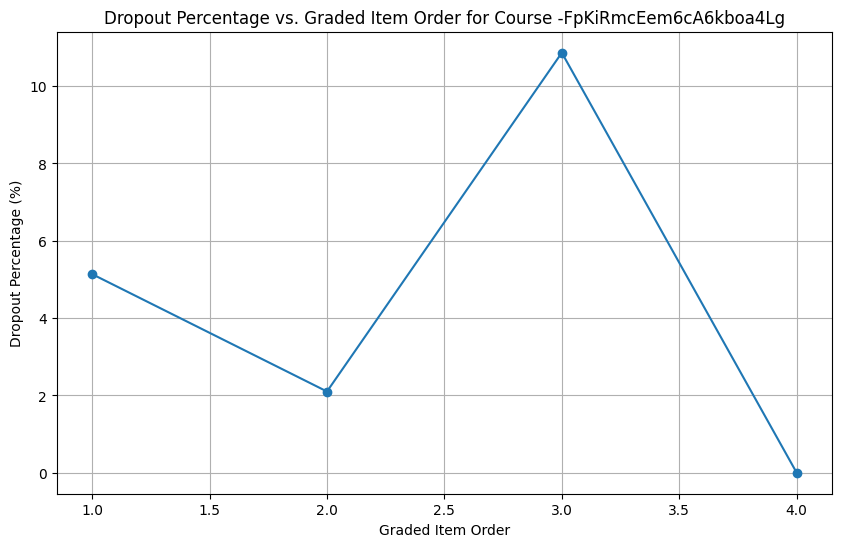

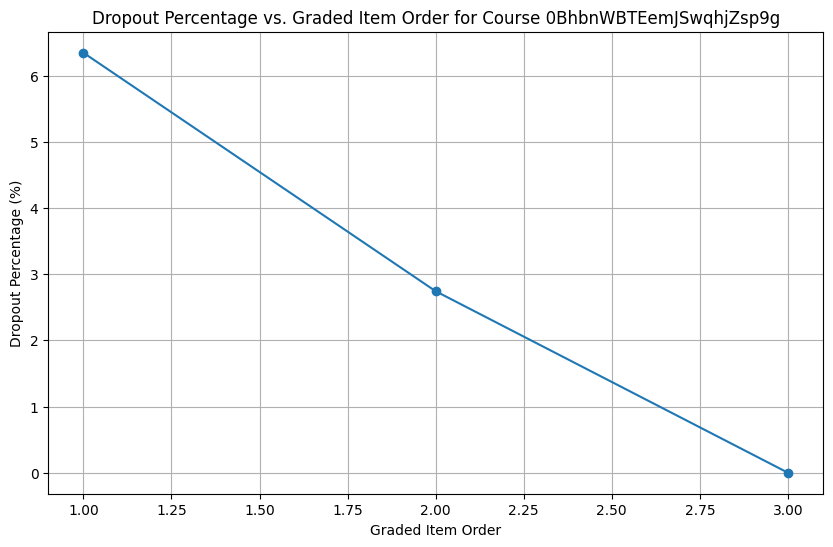

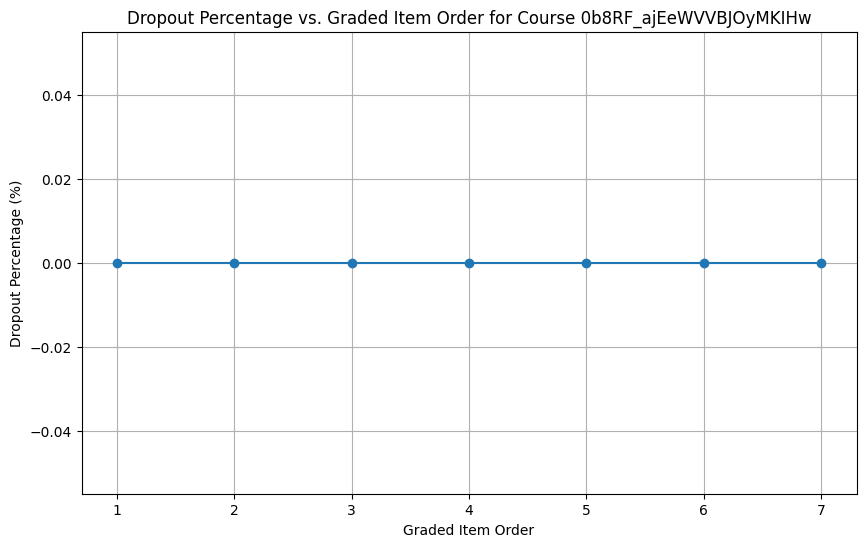

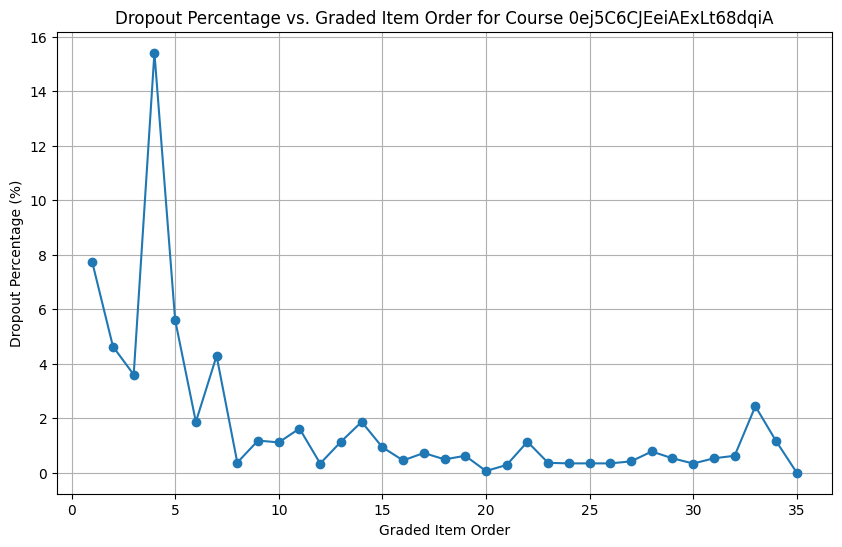

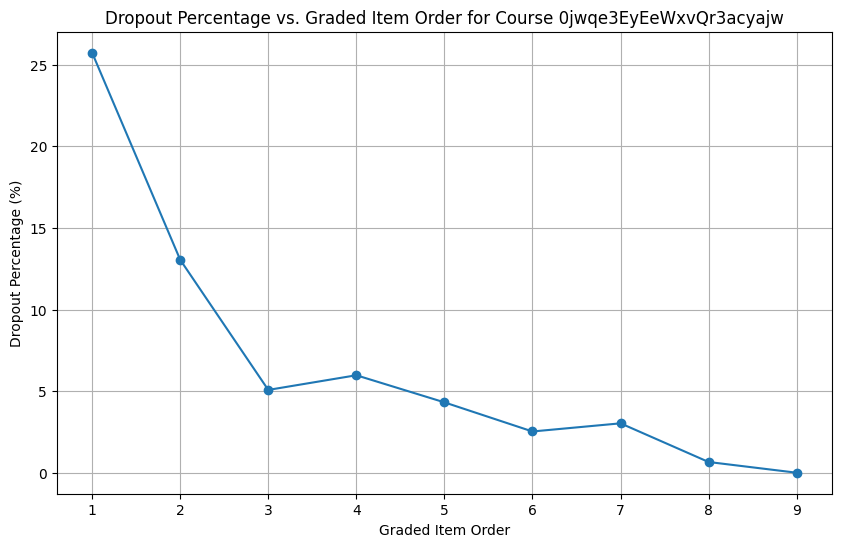

...

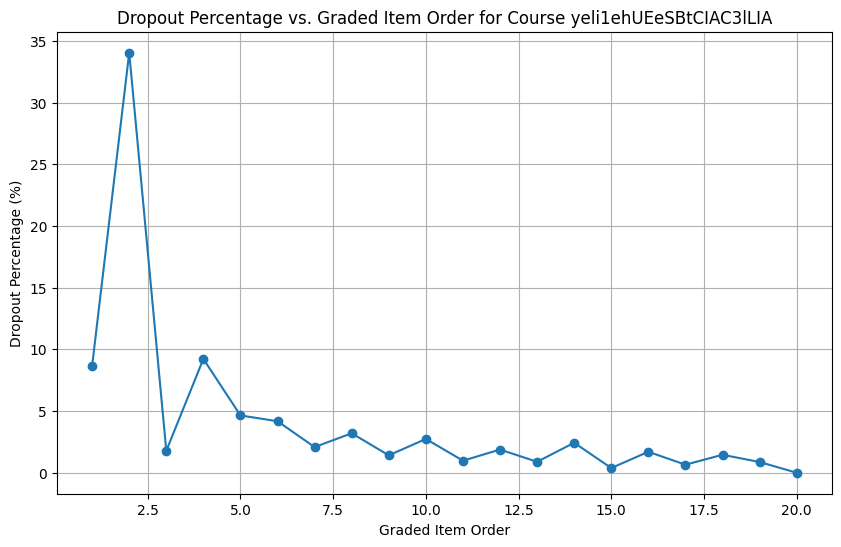

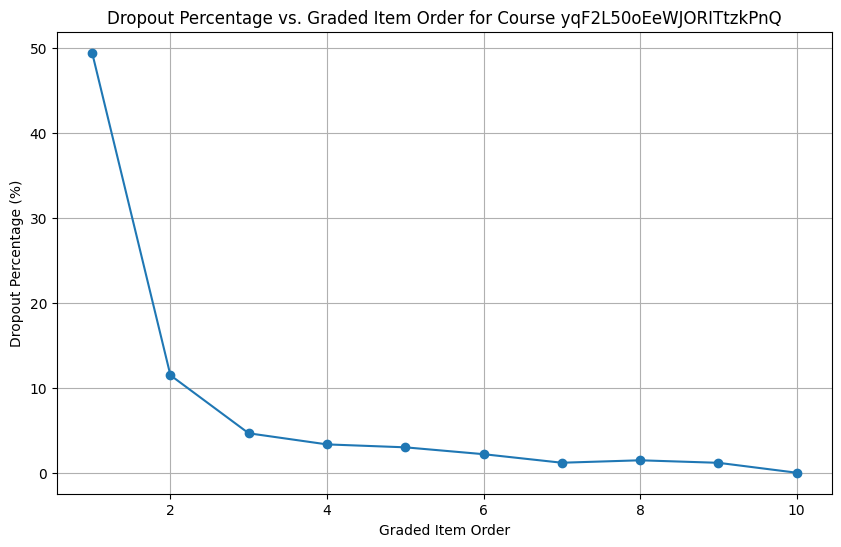

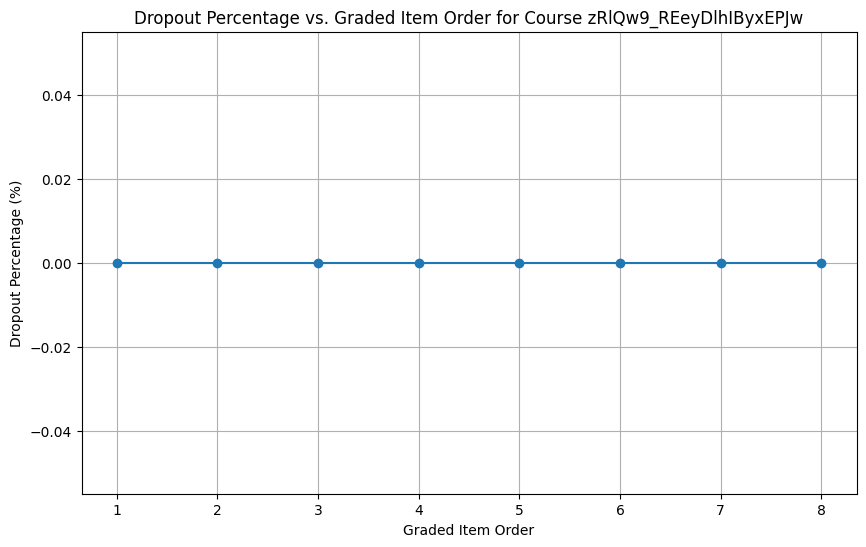

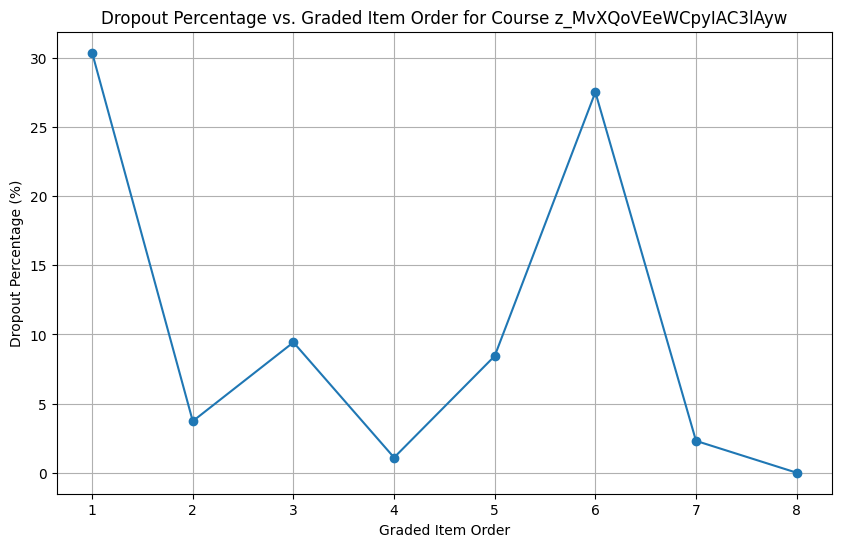

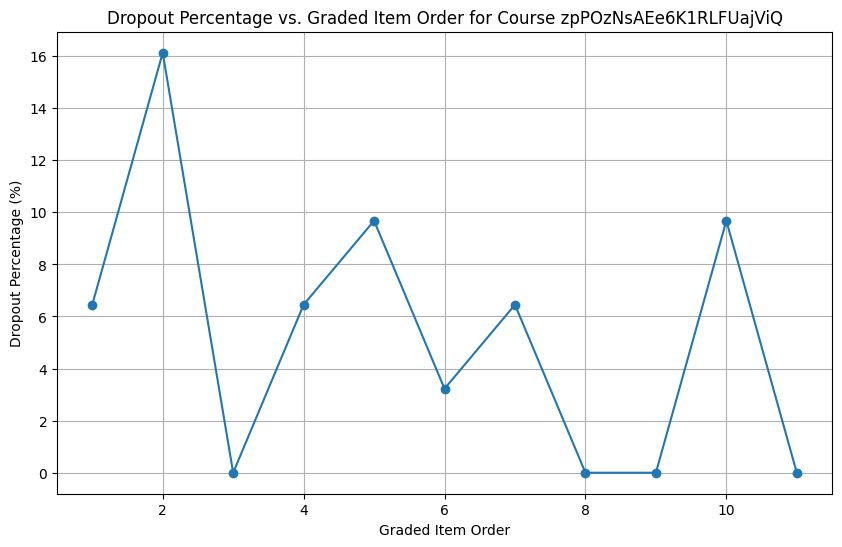

In [ ]:
import matplotlib.pyplot as plt

for course_id in graded_item_dropout_df['course_id'].unique():
    course_data = graded_item_dropout_df[graded_item_dropout_df['course_id'] == course_id]
    course_name = course_data['course_id'].iloc[0]
    plt.figure(figsize=(10, 6))
    plt.plot(course_data['graded_item_order'], course_data['dropout_percentage'] * 100, marker='o', linestyle='-', label='Dropout Percentage (%)')
    plt.title(f'Dropout Percentage vs. Graded Item Order for Course {course_name}')
    plt.xlabel('Graded Item Order')
    plt.ylabel('Dropout Percentage (%)')
    plt.grid(True)

    plt.show()

## course items distribution

In [ ]:
print(graded_item_dropout_df.columns)

Index(['course_id', 'course_item_id', 'course_branch_module_order',
       'course_branch_lesson_order', 'course_branch_item_order',
       'graded_item_order', 'num_of_items', 'dropout_item_id', 'dropout_count',
       'total_count', 'dropout_percentage'],
      dtype='object')


In [ ]:
graded_item_counts_per_course = graded_item_dropout_df.groupby('course_id')['course_item_id'].nunique().reset_index(name='num_of_items')
print(graded_item_counts_per_course.num_of_items.describe())

count    179.000000
mean       7.301676
std        6.257449
min        1.000000
25%        4.000000
50%        5.000000
75%        9.000000
max       51.000000
Name: num_of_items, dtype: float64


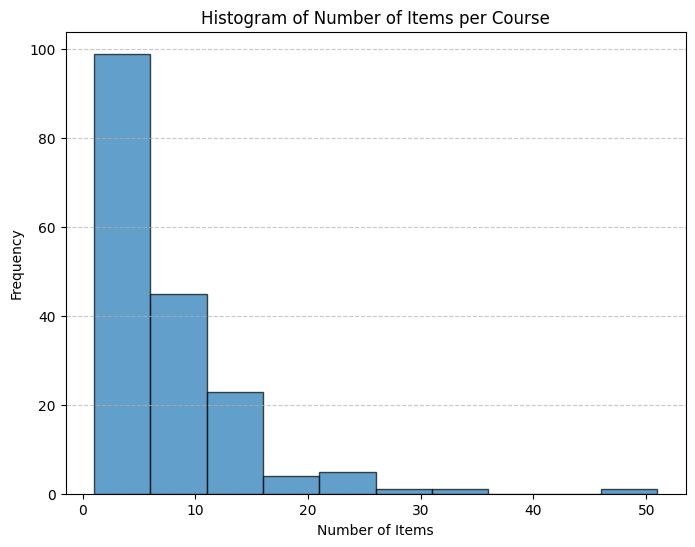

In [ ]:
import matplotlib.pyplot as plt

num_of_items = graded_item_counts_per_course['num_of_items']

# Plot the histogram
plt.figure(figsize=(8, 6))
plt.hist(num_of_items, bins=10, edgecolor='black', alpha=0.7)

# Add labels and title
plt.xlabel('Number of Items')
plt.ylabel('Frequency')
plt.title('Histogram of Number of Items per Course')

# Show the plot
plt.grid(axis='y', linestyle='--', alpha=0.7)
plt.show()

In [ ]:
print(num_of_items.value_counts().sort_index())

num_of_items
1      6
2      4
3      8
4     70
5     11
6     11
7      8
8     15
9      6
10     5
11     7
12     7
13     6
14     1
15     2
16     1
18     2
20     1
22     2
24     2
25     1
30     1
35     1
51     1
Name: count, dtype: int64


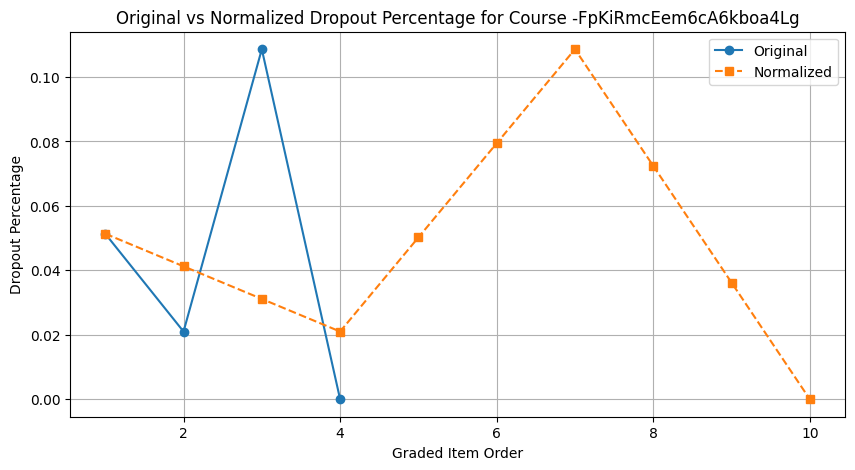

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt

# Assuming 'graded_item_dropout_df' is the existing DataFrame

# Define the target number of course items
target_items = 10

# Function to normalize dropout_percentage
def normalize_course_items(df):
    normalized_data = []

    # Group by course_id
    for course_id, group in df.groupby('course_id'):
        group = group.sort_values(by='graded_item_order')  # Sort items in the course
        num_items = group['num_of_items'].iloc[0]  # Original number of items in the course

        # Generate new indices from 1 to target_items
        new_indices = np.linspace(1, num_items, target_items)

        # Interpolate dropout_percentage to new scale
        interpolated_dropout = np.interp(new_indices, group['graded_item_order'], group['dropout_percentage'])

        # Create new dataframe entries
        for i, perc in enumerate(interpolated_dropout):
            normalized_data.append({
                'course_id': course_id,
                'normalized_graded_item_order': i + 1,
                'dropout_percentage': perc
            })

    return pd.DataFrame(normalized_data)

# Apply normalization
normalized_df = normalize_course_items(graded_item_dropout_df)

# Plot to compare original vs normalized dropout percentages for a sample course
sample_course_id = graded_item_dropout_df['course_id'].iloc[0]
original = graded_item_dropout_df[graded_item_dropout_df['course_id'] == sample_course_id]
normalized = normalized_df[normalized_df['course_id'] == sample_course_id]

plt.figure(figsize=(10, 5))
plt.plot(original['graded_item_order'], original['dropout_percentage'], marker='o', label='Original')
plt.plot(range(1, 11), normalized['dropout_percentage'], marker='s', linestyle='--', label='Normalized')
plt.xlabel('Graded Item Order')
plt.ylabel('Dropout Percentage')
plt.title(f'Original vs Normalized Dropout Percentage for Course {sample_course_id}')
plt.legend()
plt.grid()
plt.show()

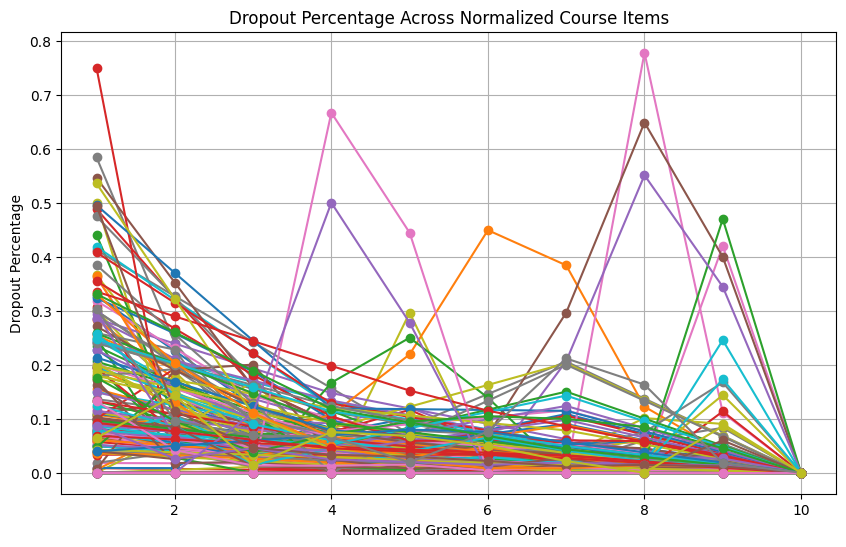

In [ ]:
import matplotlib.pyplot as plt

# Create the plot
plt.figure(figsize=(10, 6))

# Loop through each course and plot its normalized dropout percentages
for course_id in normalized_df['course_id'].unique():
    course_data = normalized_df[normalized_df['course_id'] == course_id]
    plt.plot(course_data['normalized_graded_item_order'], course_data['dropout_percentage'], marker='o', linestyle='-')

# Formatting
plt.xlabel('Normalized Graded Item Order')
plt.ylabel('Dropout Percentage')
plt.title('Dropout Percentage Across Normalized Course Items')
plt.grid()

# Remove the legend
plt.gca().legend_ = None

# Show plot
plt.show()

### normalized for all courses

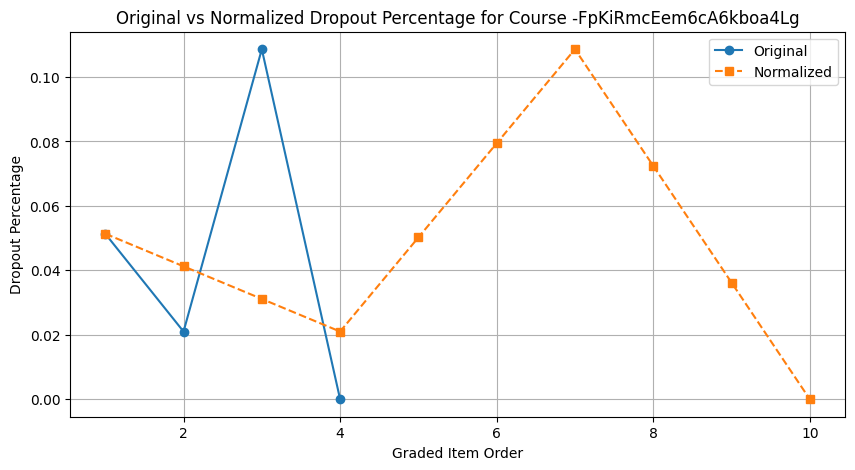

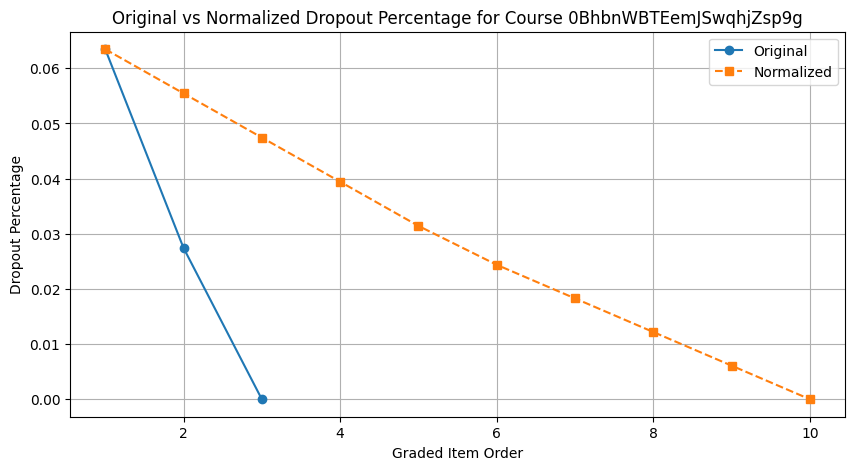

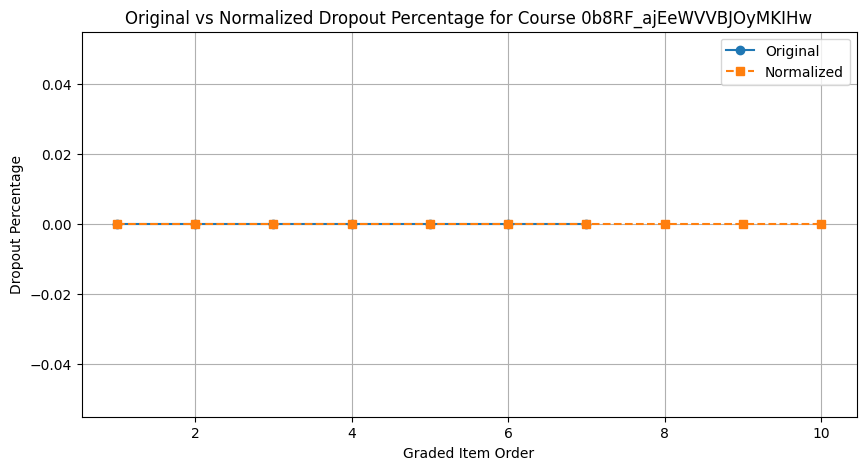

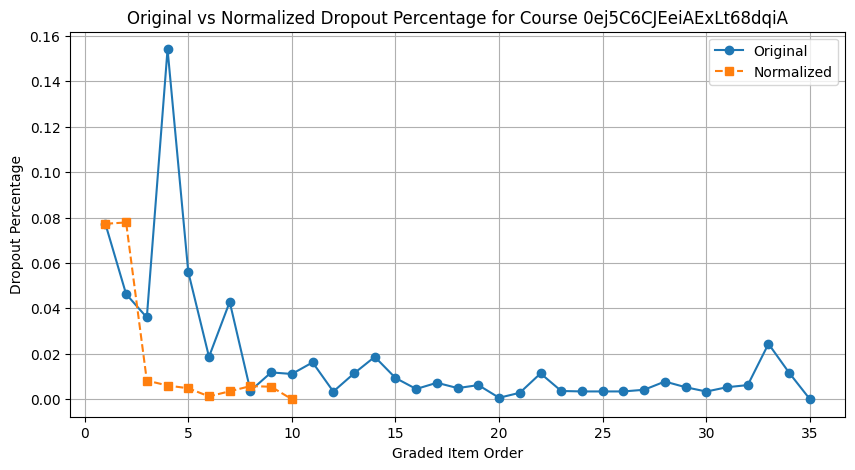

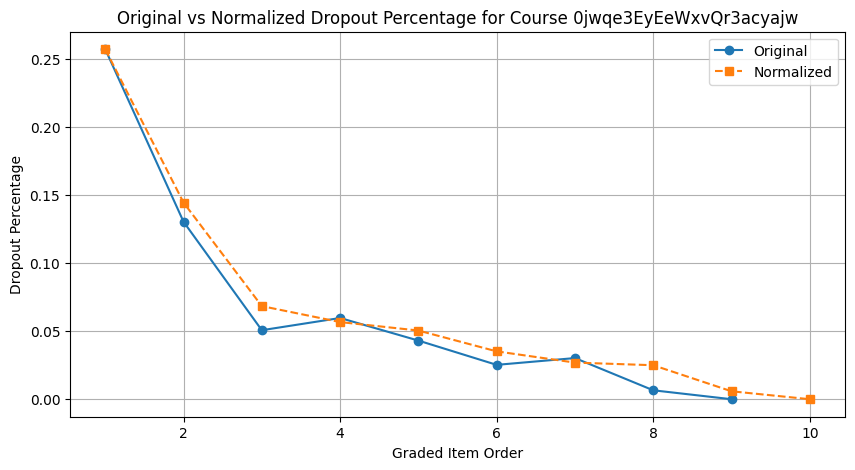

...

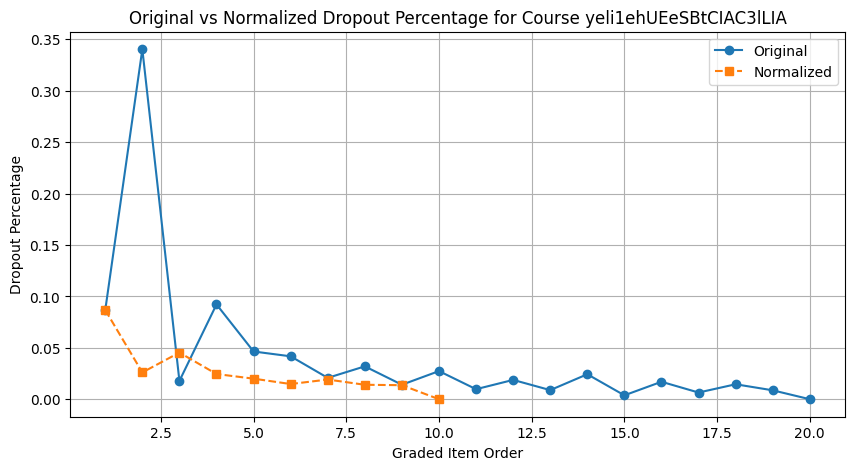

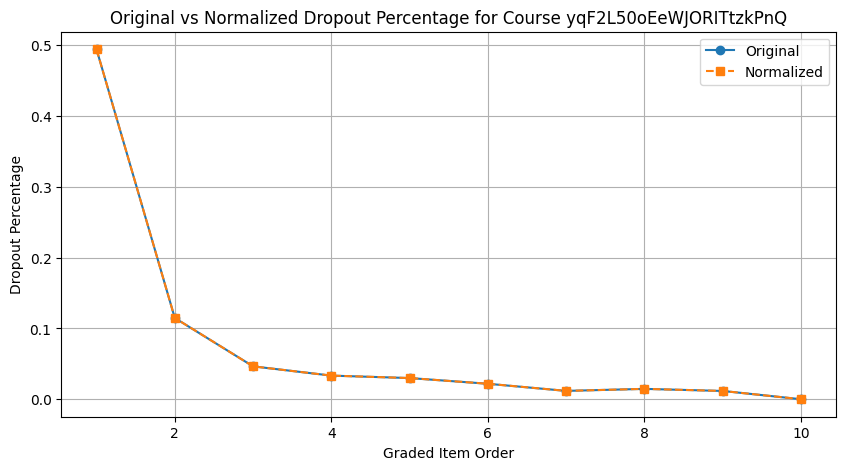

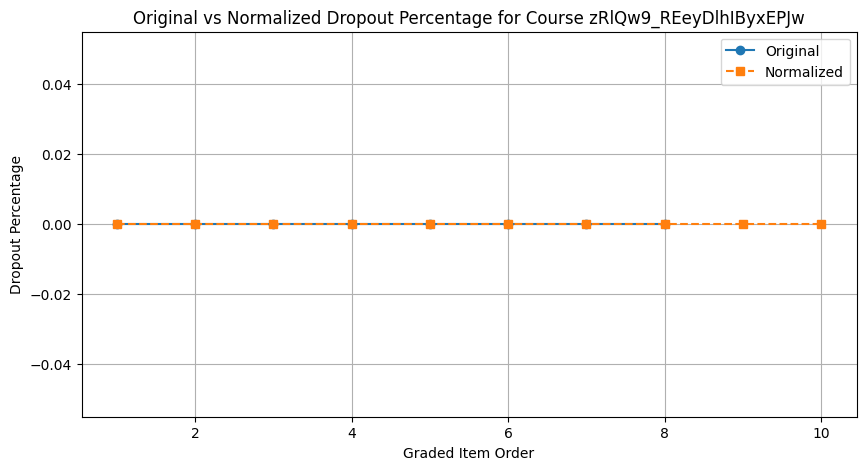

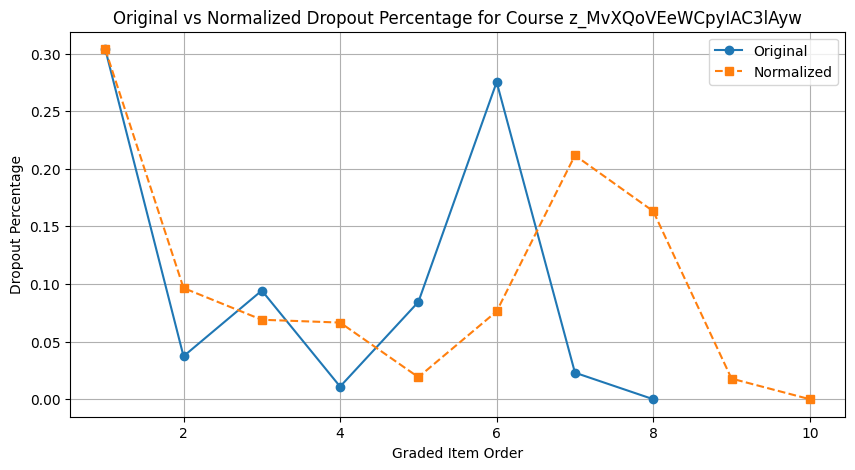

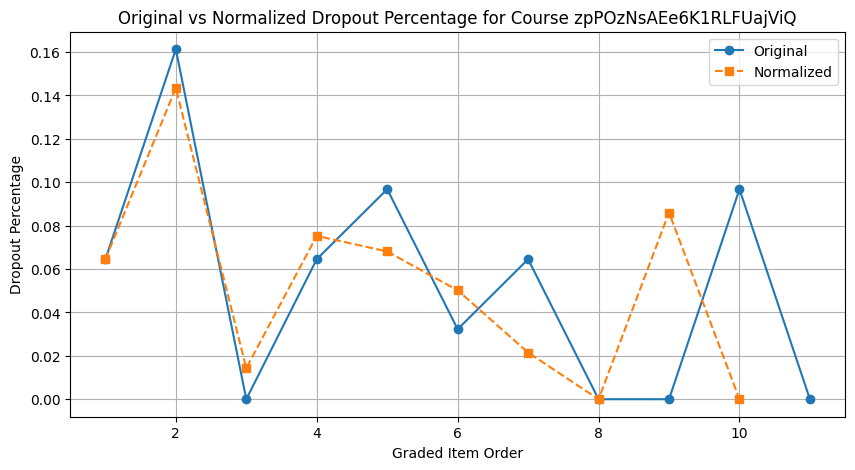

In [ ]:
import matplotlib.pyplot as plt

# Get unique course IDs
unique_courses = graded_item_dropout_df['course_id'].unique()

# Loop through each course and plot original vs. normalized dropout percentages
for course_id in unique_courses:
    original = graded_item_dropout_df[graded_item_dropout_df['course_id'] == course_id]
    normalized = normalized_df[normalized_df['course_id'] == course_id]

    plt.figure(figsize=(10, 5))
    plt.plot(original['graded_item_order'], original['dropout_percentage'], marker='o', label='Original')
    plt.plot(range(1, 11), normalized['dropout_percentage'], marker='s', linestyle='--', label='Normalized')
    plt.xlabel('Graded Item Order')
    plt.ylabel('Dropout Percentage')
    plt.title(f'Original vs Normalized Dropout Percentage for Course {course_id}')
    plt.legend()
    plt.grid()
    plt.show()

# first item dropout analysis

In [ ]:
# get first item dropout rate for each course
first_item_dropout_per_course = graded_item_dropout_df[graded_item_dropout_df['graded_item_order'] == 1]

# sanity check for each course has only 1 item
print(max(first_item_dropout_per_course.groupby('course_id')['dropout_percentage'].count()))
print(first_item_dropout_per_course.shape)

1
(179, 11)


In [ ]:
# join Xing's features on courses
first_item_dropout_with_xing = first_item_dropout_per_course.merge(
    df_xing,
    on = 'course_id',
    how = 'left'
)

In [ ]:
# join first assessments
assessment = pd.read_csv('/content/drive/MyDrive/MOOC_Feature_Project/MOOC-Pipeline/data_preprocess_EDA/cleaned_data/engineered_assessment_df.csv')

# select useful features from assessments
assessment_cleaned = assessment[['course_id', 'course_item_id', 'is_graded', 'quiz_is_graded', 'assessment_passing_fraction',
                                         'global_item_time_commitment',
                                          'question_counts', 'checkbox_percentage', 'checkboxReflect_percentage',
                                          'codeExpression_percentage', 'math expression_percentage',
                                          'mcq_percentage', 'mcqReflect_percentage', 'reflect_percentage',
                                          'regex_percentage', 'single numeric_percentage',
                                          'text exact match_percentage', 'is_staff_graded']].drop_duplicates()

In [ ]:
# merge with features of first item (one third NA)
first_item_dropout_per_course = first_item_dropout_with_xing.merge(
    assessment_cleaned,
    left_on = ['course_id', 'course_item_id'],
    right_on = ['course_id', 'course_item_id'],
    how = 'left'
)

In [ ]:
# join name of second course items
second_id_df = graded_item_dropout_df[graded_item_dropout_df['graded_item_order'] == 2][['course_id', 'course_item_id']]
second_id_df = second_id_df.rename(columns={'course_item_id': 'second_item_id'})
first_item_dropout_per_course = first_item_dropout_per_course.merge(
    second_id_df,
    on = 'course_id',
    how = 'left'
)

# join features of second course items
first_item_dropout_per_course = first_item_dropout_per_course.merge(
    assessment_cleaned,
    left_on = ['course_id', 'second_item_id'],
    right_on = ['course_id', 'course_item_id'],
    how = 'left'
)

In [ ]:
# select and rename columns
first_item_dropout_w_features = first_item_dropout_per_course[
    ['course_id', 'course_item_id_x',
      'num_of_items', 'dropout_percentage', 'course_days', 'forum_counts',
       'assessment_counts', 'asssignemnt_counts', 'required_review_counts',
       'grading_types', 'submission_types', 'is_graded_x', 'quiz_is_graded_x',
       'assessment_passing_fraction_x', 'global_item_time_commitment_x',
       'question_counts_x', 'checkbox_percentage_x',
       'checkboxReflect_percentage_x', 'codeExpression_percentage_x',
       'math expression_percentage_x', 'mcq_percentage_x',
       'mcqReflect_percentage_x', 'reflect_percentage_x', 'regex_percentage_x',
       'single numeric_percentage_x', 'text exact match_percentage_x',
       'is_staff_graded_x', 'second_item_id',
       'is_graded_y', 'quiz_is_graded_y', 'assessment_passing_fraction_y',
       'global_item_time_commitment_y', 'question_counts_y',
       'checkbox_percentage_y', 'checkboxReflect_percentage_y',
       'codeExpression_percentage_y', 'math expression_percentage_y',
       'mcq_percentage_y', 'mcqReflect_percentage_y', 'reflect_percentage_y',
       'regex_percentage_y', 'single numeric_percentage_y',
       'text exact match_percentage_y', 'is_staff_graded_y']
].drop_duplicates().reset_index(drop=True)

first_item_dropout_w_features.columns = ['course_id', 'first_item_id',
       'num_of_items', 'dropout_percentage', 'course_days', 'forum_counts',
       'assessment_counts', 'asssignemnt_counts', 'required_review_counts',
       'grading_types', 'submission_types', 'is_graded_x', 'quiz_is_graded_x',
       'assessment_passing_fraction_x', 'global_item_time_commitment_x',
       'question_counts_x', 'checkbox_percentage_x',
       'checkboxReflect_percentage_x', 'codeExpression_percentage_x',
       'math expression_percentage_x', 'mcq_percentage_x',
       'mcqReflect_percentage_x', 'reflect_percentage_x', 'regex_percentage_x',
       'single numeric_percentage_x', 'text exact match_percentage_x',
       'is_staff_graded_x', 'second_item_id',
       'is_graded_y', 'quiz_is_graded_y', 'assessment_passing_fraction_y',
       'global_item_time_commitment_y', 'question_counts_y',
       'checkbox_percentage_y', 'checkboxReflect_percentage_y',
       'codeExpression_percentage_y', 'math expression_percentage_y',
       'mcq_percentage_y', 'mcqReflect_percentage_y', 'reflect_percentage_y',
       'regex_percentage_y', 'single numeric_percentage_y',
       'text exact match_percentage_y', 'is_staff_graded_y']

In [ ]:
print(first_item_dropout_w_features.columns)

Index(['course_id', 'first_item_id', 'num_of_items', 'dropout_percentage',
       'course_days', 'forum_counts', 'assessment_counts',
       'asssignemnt_counts', 'required_review_counts', 'grading_types',
       'submission_types', 'is_graded_x', 'quiz_is_graded_x',
       'assessment_passing_fraction_x', 'global_item_time_commitment_x',
       'question_counts_x', 'checkbox_percentage_x',
       'checkboxReflect_percentage_x', 'codeExpression_percentage_x',
       'math expression_percentage_x', 'mcq_percentage_x',
       'mcqReflect_percentage_x', 'reflect_percentage_x', 'regex_percentage_x',
       'single numeric_percentage_x', 'text exact match_percentage_x',
       'is_staff_graded_x', 'second_item_id', 'is_graded_y',
       'quiz_is_graded_y', 'assessment_passing_fraction_y',
       'global_item_time_commitment_y', 'question_counts_y',
       'checkbox_percentage_y', 'checkboxReflect_percentage_y',
       'codeExpression_percentage_y', 'math expression_percentage_y',
       'mc

In [ ]:
first_dropout_no_na = first_item_dropout_w_features.dropna().reset_index()
# remove duplicates of course id
first_dropout_no_na = first_dropout_no_na.drop_duplicates(subset=['course_id'], keep='first')

# only 101 courses left
print(first_dropout_no_na.shape)

(101, 45)


### output first_droupout_percent

In [ ]:
first_dropout_no_na.to_csv('/content/drive/MyDrive/MOOC_Feature_Project/MOOC-Pipeline/data_preprocess_EDA/cleaned_data/clean_first_dropout_w_features.csv', index=False)

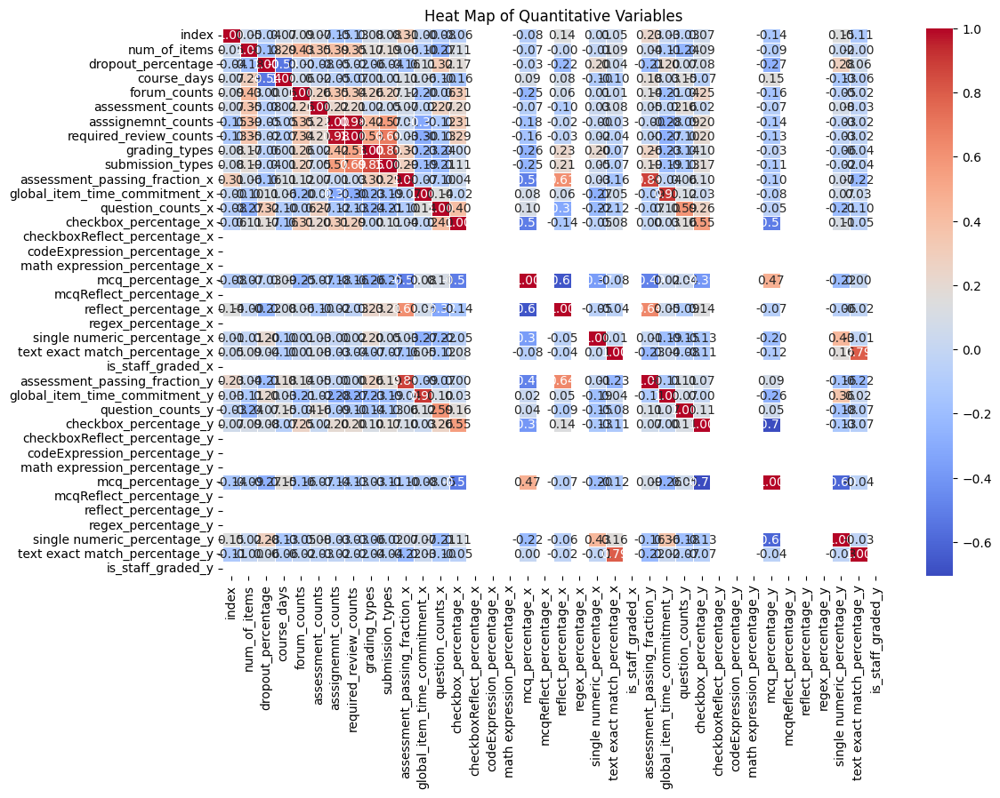

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Select only quantitative (numeric) columns
quantitative_vars = first_dropout_no_na.select_dtypes(include=['number'])

# Compute the correlation matrix
corr_matrix = quantitative_vars.corr()

# Plot the heatmap
plt.figure(figsize=(12, 8))  # Adjust size for better readability
sns.heatmap(corr_matrix, annot=True, fmt=".2f", cmap="coolwarm", linewidths=0.5)

# Add title
plt.title("Heat Map of Quantitative Variables")

# Show plot
plt.show()

In [ ]:
print(first_dropout_no_na.isna().sum())

index                            0
course_id                        0
first_item_id                    0
num_of_items                     0
dropout_percentage               0
course_days                      0
forum_counts                     0
assessment_counts                0
asssignemnt_counts               0
required_review_counts           0
grading_types                    0
submission_types                 0
is_graded_x                      0
quiz_is_graded_x                 0
assessment_passing_fraction_x    0
global_item_time_commitment_x    0
question_counts_x                0
checkbox_percentage_x            0
checkboxReflect_percentage_x     0
codeExpression_percentage_x      0
math expression_percentage_x     0
mcq_percentage_x                 0
mcqReflect_percentage_x          0
reflect_percentage_x             0
regex_percentage_x               0
single numeric_percentage_x      0
text exact match_percentage_x    0
is_staff_graded_x                0
second_item_id      

In [ ]:
# Compute correlation matrix
corr_matrix = quantitative_vars.corr()

# Extract the correlation vector for dropout_percentage
dropout_corr = corr_matrix['dropout_percentage']

# Display the correlation vector
print(dropout_corr)

index                           -0.041534
num_of_items                    -0.184508
dropout_percentage               1.000000
course_days                     -0.536328
forum_counts                     0.000315
assessment_counts               -0.078148
asssignemnt_counts              -0.050785
required_review_counts          -0.020226
grading_types                   -0.056223
submission_types                -0.037140
assessment_passing_fraction_x   -0.156148
global_item_time_commitment_x    0.113115
question_counts_x                0.318776
checkbox_percentage_x            0.173896
checkboxReflect_percentage_x          NaN
codeExpression_percentage_x           NaN
math expression_percentage_x          NaN
mcq_percentage_x                -0.029061
mcqReflect_percentage_x               NaN
reflect_percentage_x            -0.221788
regex_percentage_x                    NaN
single numeric_percentage_x      0.203794
text exact match_percentage_x    0.041353
is_staff_graded_x                 